In [3]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import scipy.ndimage
from skimage.metrics import mean_squared_error
from copy import deepcopy

#Image Fundamentals

#1.1.1

##Mean Squared Error

In [5]:
def MSE(a,b):
  #mse = (1/mn)EE(a-b)^2
  err = np.mean((np.square(np.float32(a)-np.float32(b))))
  # err = np.square(np.subtract(np.float32(a),np.float32(b))).mean()
  return err

##Equalized Image Quantization

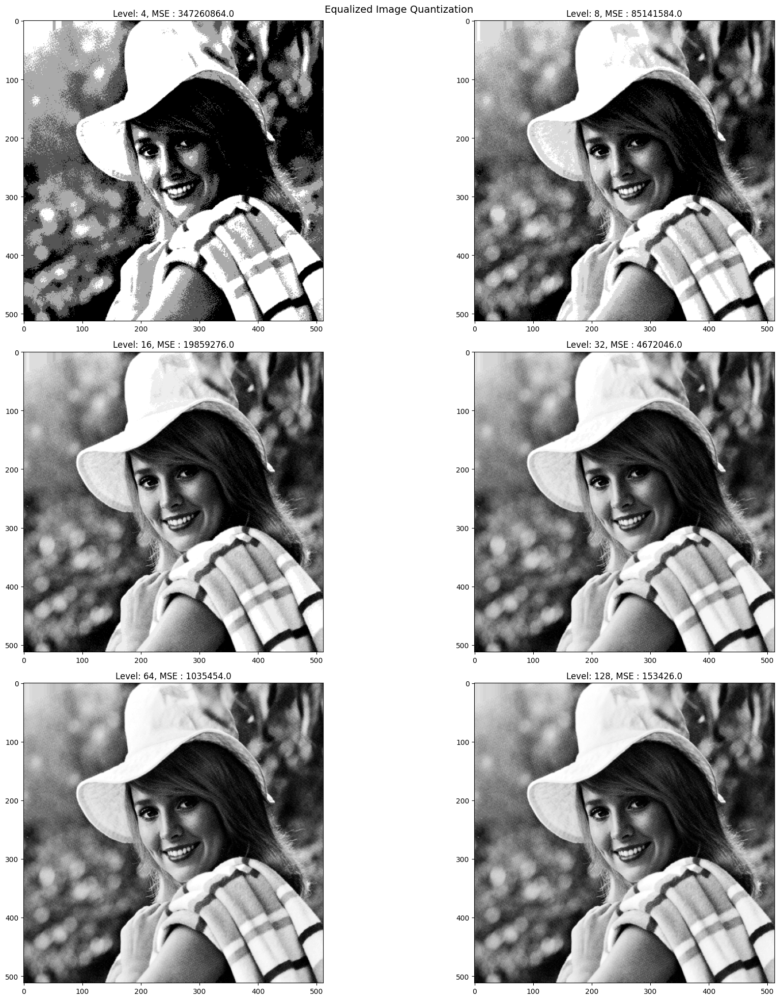

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import scipy.ndimage

#Read the image
img = cv2.imread("Elaine.bmp")
#Convert to GrayScale
img_gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
#histogram equalization
img_equilized = cv2.equalizeHist(img_gray)
#Convert to array
img_array = np.array(img_equilized)
Levels = [4,8,16,32,64,128]
quantized_array = list(np.zeros(len(Levels)))
#Quantization
for i in range(len(Levels)):
  l = 256/Levels[i]
  quantized_array[i] = np.floor(img_array // l)*l
#Display
fig, axes = plt.subplots(3, 2, figsize=(20, 20))
fig.suptitle("Equalized Image Quantization", fontsize=14)
# for i in range(len(Levels)):
#   axes[i // 3,i % 3].imshow(quantized_array[i],cmap="gray")
#   axes[i // 3,i % 3].set_title(f"Level: {Levels[i]}", fontsize=12)
for j in range(3):
   for i in range(2):
     axes[j,i].imshow(quantized_array[(2*j)+i], cmap='gray')
     axes[j,i].set_title(f"Level: {Levels[(2*j)+i]}, MSE : {MSE(img_equilized,quantized_array[(2*j)+i])}", fontsize=12)

plt.tight_layout()
plt.show()

#Display with cv2_imshow
# for i in range(len(Levels)):
  # print(f"\nLevel : {Levels[i]} \n")
  # print(f"\nMSE from original image : {MSE(img_equilized,quantized_array[i])}\n")
  # cv2_imshow(quantized_array[i])

##Equalized Image Histogram

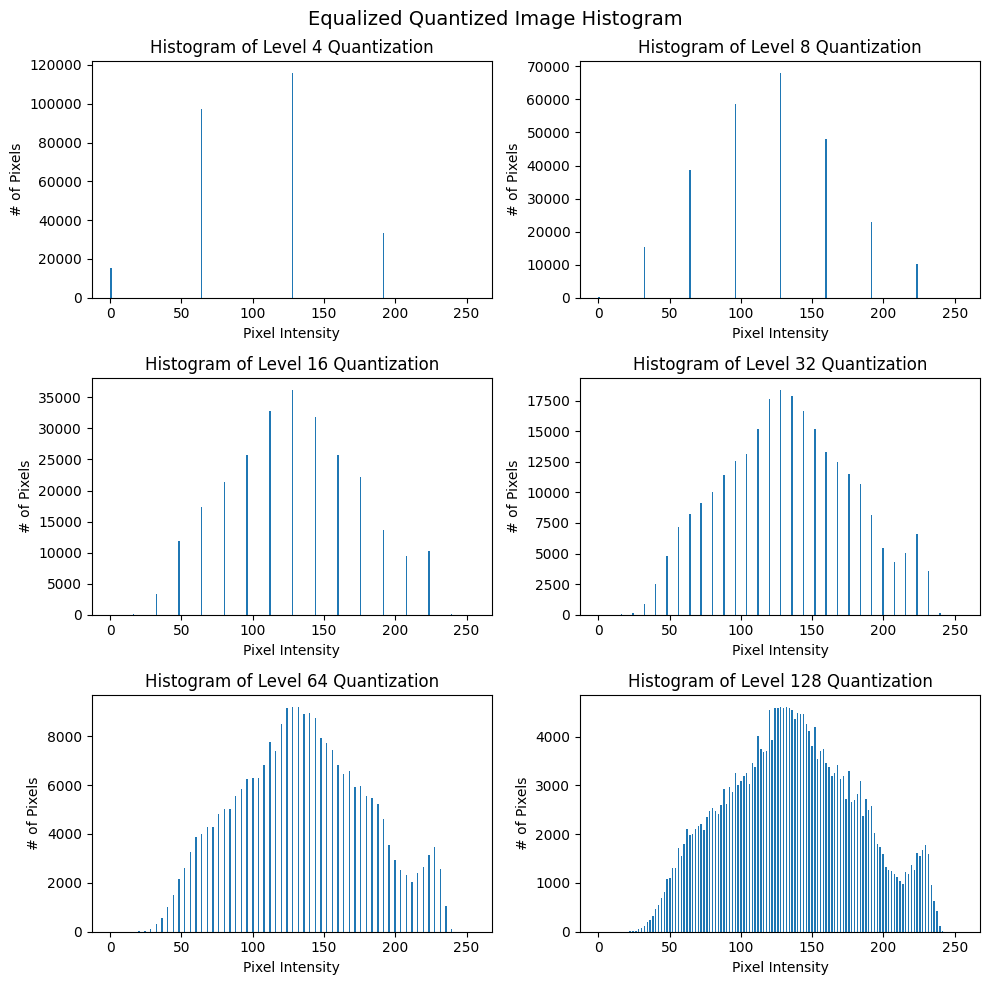

In [ ]:
fig, axs = plt.subplots(3, 2, figsize=(10,10))
fig.suptitle("Equalized Quantized Image Histogram", fontsize=14)

for j in range(3):
   for i in range(2):
    axs[j,i].hist(quantized_array[(2*j)+i].ravel(),bins=256,range=(0,255))
    axs[j,i].set_title(f'Histogram of Level {Levels[(2*j)+i]} Quantization')
    axs[j,i].set_xlabel('Pixel Intensity')
    axs[j,i].set_ylabel('# of Pixels')

plt.tight_layout()
plt.show()

##Unequalized Image Quantization

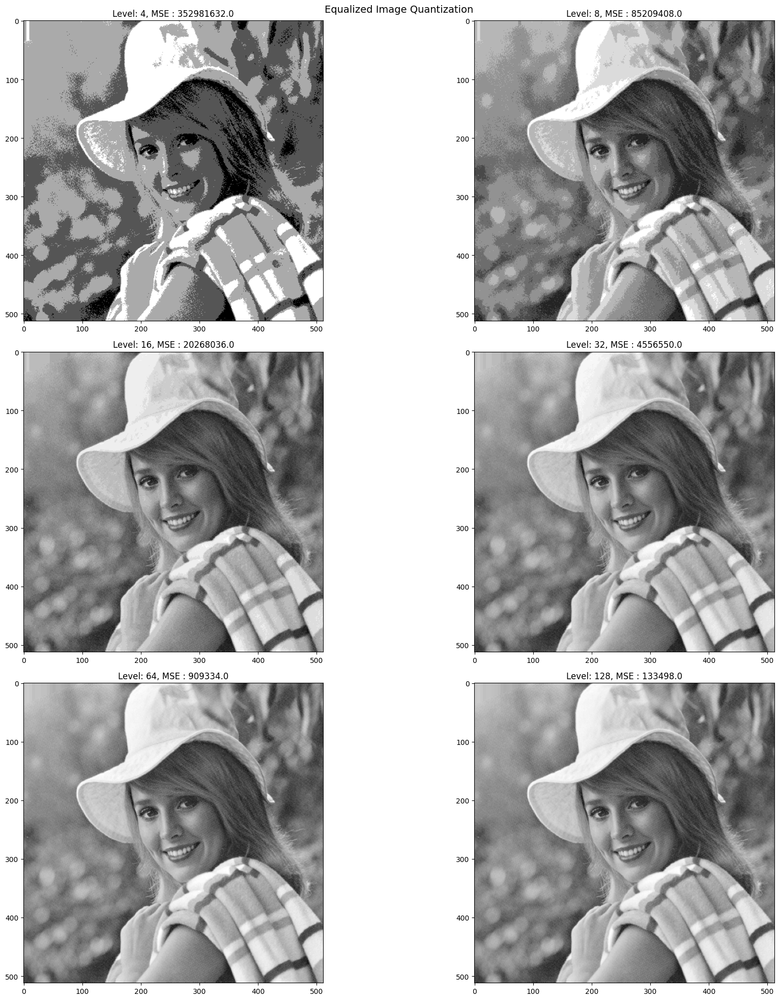

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

#Read the image
img = cv2.imread("Elaine.bmp")
#Convert to GrayScale
img_gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
#Convert to array
img_array = np.array(img_gray)
Levels = [4,8,16,32,64,128]
quantized_array = list(np.zeros(len(Levels)))
#Quantization
for i in range(len(Levels)):
  l = 256/Levels[i]
  quantized_array[i] = np.floor(img_array // l)*l
#Display
fig, axes = plt.subplots(3, 2, figsize=(20, 20))
fig.suptitle("Equalized Image Quantization", fontsize=14)
# for i in range(len(Levels)):
#   axes[i // 3,i % 3].imshow(quantized_array[i],cmap="gray")
#   axes[i // 3,i % 3].set_title(f"Level: {Levels[i]}", fontsize=12)
for j in range(3):
   for i in range(2):
     axes[j,i].imshow(quantized_array[(2*j)+i], cmap='gray')
     axes[j,i].set_title(f"Level: {Levels[(2*j)+i]}, MSE : {MSE(img_gray,quantized_array[(2*j)+i])}", fontsize=12)

plt.tight_layout()
plt.show()
#Display cv2_imshow
# for i in range(len(Levels)):
#   print(f"\nLevel : {Levels[i]} \n")
#   print(f"\nMSE from original image : {MSE(img_gray,quantized_array[i])}\n")
#   cv2_imshow(quantized_array[i])

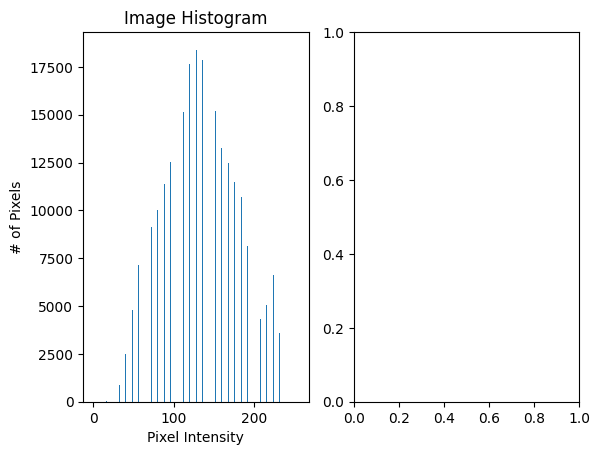

In [ ]:
fig, axs = plt.subplots(1, 2)
axs[0].hist(quantized_array[3].ravel(),bins=256,range=(0,255))
axs[0].set_title('Image Histogram')
axs[0].set_xlabel('Pixel Intensity')
axs[0].set_ylabel('# of Pixels')

# Show the plot
plt.show()

#1.1.2

##Downsample without Averaging Filter


 Original Image:



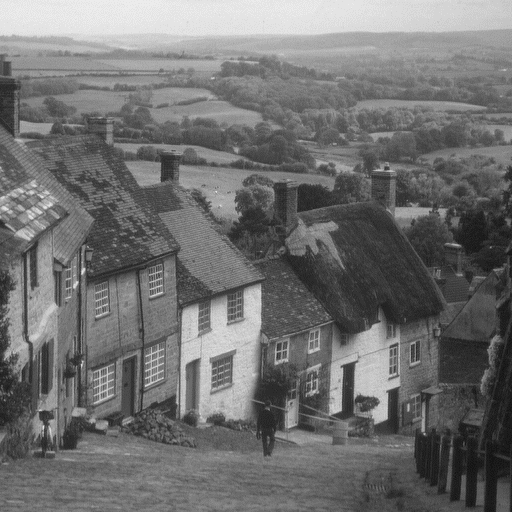


 Down Sampled Image:



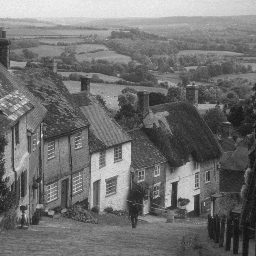


 Zoomed Down Sampled Image:



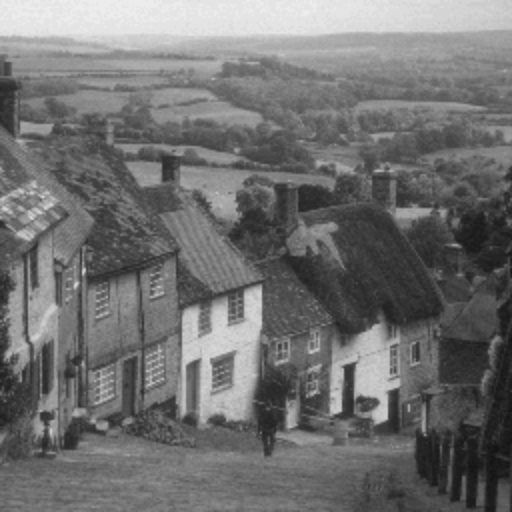

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

#import image
img = cv2.imread("Goldhill.bmp")
f = 2
# down_sampled_img = img.resize((int(img.width/2), int(img.height/2)))
down_sampled_img = img[::f, ::f]
rows,cols,chanel = img.shape
down_sampled_img_resized = cv2.resize(down_sampled_img,(rows, cols))
print(f"\n Original Image:\n")
cv2_imshow(img)
print(f"\n Down Sampled Image:\n")
cv2_imshow(down_sampled_img)
print(f"\n Zoomed Down Sampled Image:\n")
cv2_imshow(down_sampled_img_resized)


#Display
# fig, axes = plt.subplots(1, 2, figsize=(10, 10))
# fig.suptitle("Down_Sampled Image", fontsize=14)

# axes[0,0].imshow(quantized_array[(2*j)+i], cmap='gray')
# axes[0,0].set_title(f"Level: {Levels[(2*j)+i]}, MSE : {MSE(img_gray,quantized_array[(2*j)+i])}", fontsize=12)

# plt.tight_layout()
# plt.show()

##Upsampling the Downsampled Image without Averaging

###Pixel Replication


Upsampled Image With Pixel Replication:



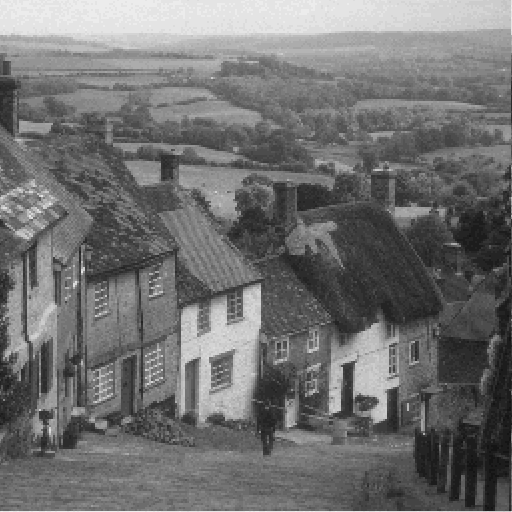

In [ ]:
s = 2
rows , cols , channels = down_sampled_img.shape
upsampled_img = np.zeros((2*rows,2*cols,channels), dtype=img.dtype)

for c in range(channels):
  for x in range(rows):
    for y in range(cols):
      j = s*(x-1) + 1
      i = s*(y-1) + 1
      upsampled_img[j,i] = down_sampled_img[x,y]
      upsampled_img[j+1,i] = down_sampled_img[x,y]
      upsampled_img[j,i+1] = down_sampled_img[x,y]
      upsampled_img[j+1,i+1] = down_sampled_img[x,y]

print(f"\nUpsampled Image With Pixel Replication:\n")
cv2_imshow(upsampled_img)

In [ ]:
MSE(img,upsampled_img)

135783360.0

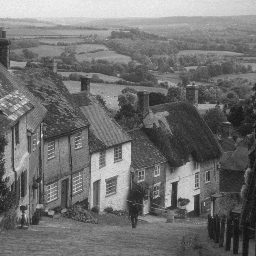

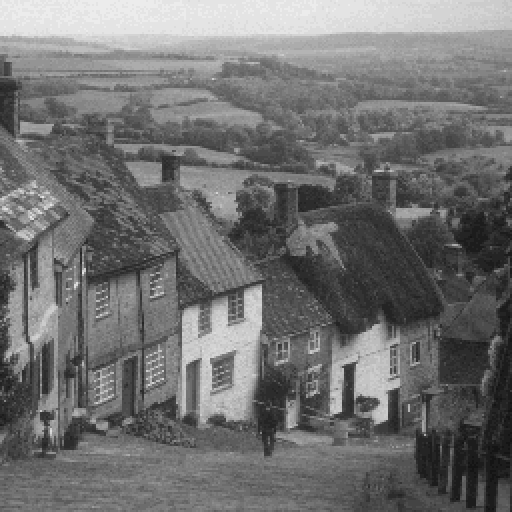

In [ ]:
rows, cols, channels = img.shape
rows_d, cols_d, channels_d = down_sampled_img.shape

scale = 2

inter_rows = np.ceil(np.arange(1, (rows_d*scale)+1)/scale).astype(int)
inter_cols = np.ceil(np.arange(1, (cols_d*scale)+1)/scale).astype(int)

upsampled_img = down_sampled_img[:, inter_cols - 1]
upsampled_img = upsampled_img[inter_rows - 1, :]

cv2_imshow(down_sampled_img)
cv2_imshow(upsampled_img)

#what am i doing here?

In [ ]:
rows, cols, channels = img.shape
rows_d, cols_d, channels_d = down_sampled_img.shape
resized_img = np.zeros((rows,cols,channels), dtype=img.dtype)

upsampled_rows = rows_d*2
upsampled_cols = cols_d*2

print(f"{upsampled_rows} , {upsampled_cols}")

upsampled_img = down_sampled_img[: , upsampled_cols -1]
upsampled_img = upsampled_img[upsampled_rows - 1 , :]

cv2_imshow(upsampled_img)

###Bilinear Interpolation

In [ ]:
def bi_interpolation(img , x, y):
  rows ,cols ,channels = img.shape

  x1 = int(x) ; y1 = int(y) ; x2 = x1 +1 ; y2 = y1 + 1

  if x2 > rows : x2 = x1
  if y2 > cols : y2 = y1

  # p11 = img[y1 , x1] ; p12 = img[y2 , x1]  ; p21 = img[y1 , x2] ; p22 = img[y2 , x2]
  p11 = img[x-1 , y+1] ; p12 = img[x+1 , y+1]  ; p21 = img[x-1 , y-1] ; p22 = img[x+1 , y-1]

#Cubic interpolation
  # interpolated = int(0)
  # for i in range(4):
  #   for j in range(4):
  #     p = img[i , j]
  #     d_x = x - i
  #     d_y = y - j
  #     if d_x > 0 :
  #       d_x = int(1 - np.abs(d_x))
  #     if d_y > 0 :
  #       d_y = int(1 - np.abs(d_y))
  #     interpolated += p * d_x *d_y

  # d_x = x - x2
  # d_y = y - y2
  d_x = 1/4
  d_y = 1/4

  interpolated = (p11 * (1 - d_x) * (1-d_y) +
                  p21 * d_x * (1 - d_y) +
                  p12 * (1 - d_x) * d_y +
                  p22 * d_x * d_y)

  # interpolated = (p11 * (1 - np.abs(p11[0]-x)) * (1-np.abs(p11[1]-y)) +
  #                 p21 * np.abs(p21[0]-x) * (1 - np.abs(p21[1]-y)) +
  #                 p12 * (1 - np.abs(p12[0]-x)) * np.abs(p12[1]-y) +
  #                 p22 * np.abs(p22[0]-x) * np.abs(p22[1]-y))
  # print(f"x:{x} , x1:{x1} , y:{y} , y1:{y1} , d_x:{d_x} , d_y:{d_y} , p11:{p11[0]} , p12:{p12[0]} , p21:{p21[0]} , p22:{p22[0]} , interpolated:{interpolated[0]}")

  return interpolated

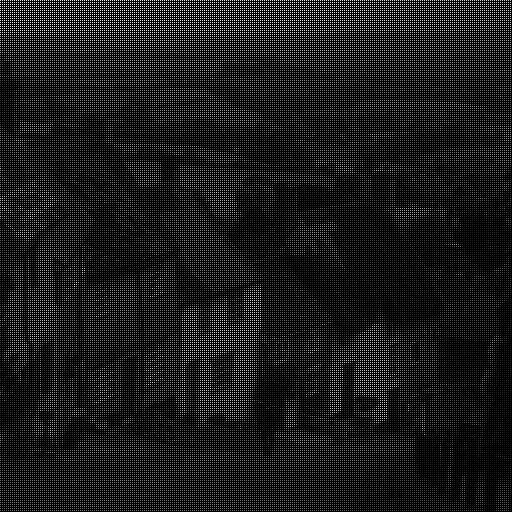


Upsampled Image with Interpolation:



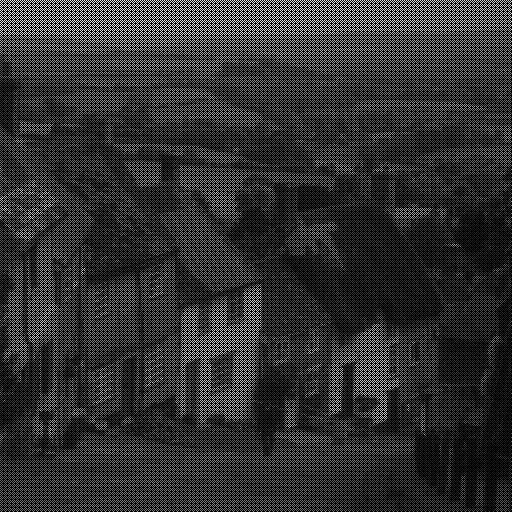

In [ ]:
rows, cols, channels = img.shape
rows_d, cols_d, channels_d = down_sampled_img.shape
resized_img = np.zeros((rows,cols,channels), dtype=img.dtype)

scale = 2

for cha in range(channels_d):
  for row in range(rows_d):
    for col in range(cols_d):
      resized_img[row*scale][col*scale][cha] = down_sampled_img[row][col][cha]

cv2_imshow(resized_img)
# print(f"{resized_img[12,16,0]}")

# for cha in range(channels):
for row in range(rows_d):
  for col in range(cols_d):
    # print(resized_img[row*scale-1,col*scale-1])
    # resized_img[row*scale-1,col*scale-1] = bi_interpolation(resized_img, row*scale-1, col*scale-1)
    # print(resized_img[row*scale-1,col*scale-1])
    if row%2!=0 or col%2!=0:
      interpolated_value = bi_interpolation(resized_img, row*scale-1, col*scale-1)
      resized_img[row*scale-1][col*scale-1] = interpolated_value

# print(f"\nStrethced image without adding Values:\n")
# cv2_imshow(resized_img)

# for cha in range(channels):
#   for row in range(rows):
#     for col in range(cols):
#       j = scale*(row-1) + 1
#       i = scale*(col-1) + 1
#       upsampled_img[j,i] = down_sampled_img[row,col]
#       upsampled_img[j+1,i] = down_sampled_img[row,col]
#       upsampled_img[j,i+1] = down_sampled_img[row,col]
#       upsampled_img[j+1,i+1] = down_sampled_img[row,col]
      # d = NONe
      # resized_img[row][col][cha] = resized_img[row+1][col+1][cha] + resized_img[row+1][col-1][cha] + resized_img[row-1][col+1][cha] +resized_img[row-1][col-1][cha]

print(f"\nUpsampled Image with Interpolation:\n")
cv2_imshow(resized_img)
# print(f"{resized_img[12,16,0]}")



In [ ]:
MSE(img,resized_img)

6657233400.0

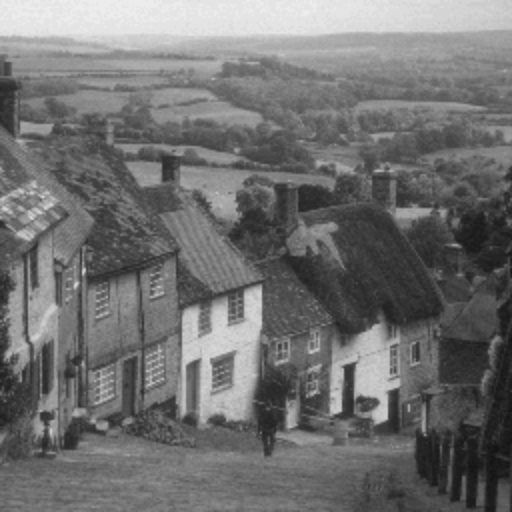

In [ ]:
rows,columns,chanels = img.shape
resized_img = cv2.resize(down_sampled_img , (rows,columns),interpolation=cv2.INTER_LINEAR)
cv2_imshow(resized_img)

##Downsample with Averaging Filter

###PixelReplication

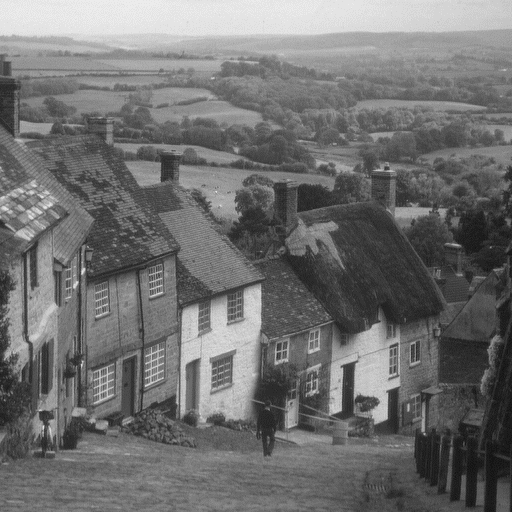

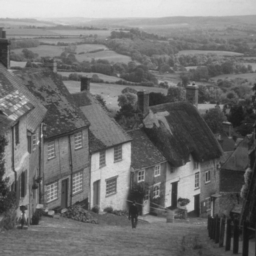

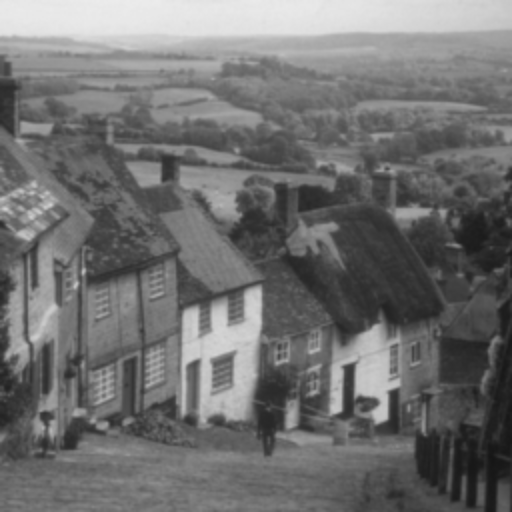

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

#import image
img = cv2.imread("Goldhill.bmp")
avg_filter = np.ones((3, 3), np.float32) / 9
blurred_img = cv2.filter2D(img, -1, avg_filter)
down_sampled_img = blurred_img[::2, ::2]
rows,cols,chanel = img.shape
down_sampled_img_resized = cv2.resize(down_sampled_img,(rows, cols))
cv2_imshow(img)
cv2_imshow(down_sampled_img)
cv2_imshow(down_sampled_img_resized)

##Upsampling the Downsampled Image with Averaging


Upsampled Image With Pixel Replication:



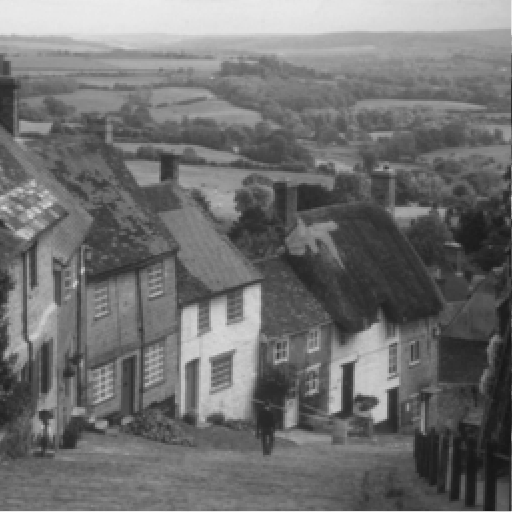

In [ ]:
s = 2
rows , cols , channels = down_sampled_img.shape
upsampled_img = np.zeros((2*rows,2*cols,channels), dtype=img.dtype)

for c in range(channels):
  for x in range(rows):
    for y in range(cols):
      j = s*(x-1) + 1
      i = s*(y-1) + 1
      upsampled_img[j,i] = down_sampled_img[x,y]
      upsampled_img[j+1,i] = down_sampled_img[x,y]
      upsampled_img[j,i+1] = down_sampled_img[x,y]
      upsampled_img[j+1,i+1] = down_sampled_img[x,y]

print(f"\nUpsampled Image With Pixel Replication:\n")
cv2_imshow(upsampled_img)

In [ ]:
MSE(img,upsampled_img)

104655170.0

In [ ]:
def bi_interpolation(img , x, y):
  rows ,cols ,channels = img.shape

  x1 = int(x) ; y1 = int(y) ; x2 = x1 +1 ; y2 = y1 + 1

  if x2 > rows : x2 = x1
  if y2 > cols : y2 = y1

  # p11 = img[y1 , x1] ; p12 = img[y2 , x1]  ; p21 = img[y1 , x2] ; p22 = img[y2 , x2]
  p11 = img[x-1 , y+1] ; p12 = img[x+1 , y+1]  ; p21 = img[x-1 , y-1] ; p22 = img[x+1 , y-1]

#Cubic interpolation
  # interpolated = int(0)
  # for i in range(4):
  #   for j in range(4):
  #     p = img[i , j]
  #     d_x = x - i
  #     d_y = y - j
  #     if d_x > 0 :
  #       d_x = int(1 - np.abs(d_x))
  #     if d_y > 0 :
  #       d_y = int(1 - np.abs(d_y))
  #     interpolated += p * d_x *d_y

  # d_x = x - x2
  # d_y = y - y2
  d_x = 1/4
  d_y = 1/4

  interpolated = (p11 * (1 - d_x) * (1-d_y) +
                  p21 * d_x * (1 - d_y) +
                  p12 * (1 - d_x) * d_y +
                  p22 * d_x * d_y)

  # interpolated = (p11 * (1 - np.abs(p11[0]-x)) * (1-np.abs(p11[1]-y)) +
  #                 p21 * np.abs(p21[0]-x) * (1 - np.abs(p21[1]-y)) +
  #                 p12 * (1 - np.abs(p12[0]-x)) * np.abs(p12[1]-y) +
  #                 p22 * np.abs(p22[0]-x) * np.abs(p22[1]-y))
  # print(f"x:{x} , x1:{x1} , y:{y} , y1:{y1} , d_x:{d_x} , d_y:{d_y} , p11:{p11[0]} , p12:{p12[0]} , p21:{p21[0]} , p22:{p22[0]} , interpolated:{interpolated[0]}")

  return interpolated

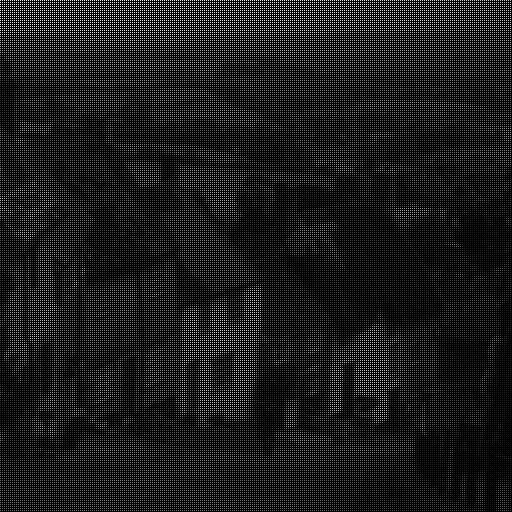


Upsampled Image with Interpolation:



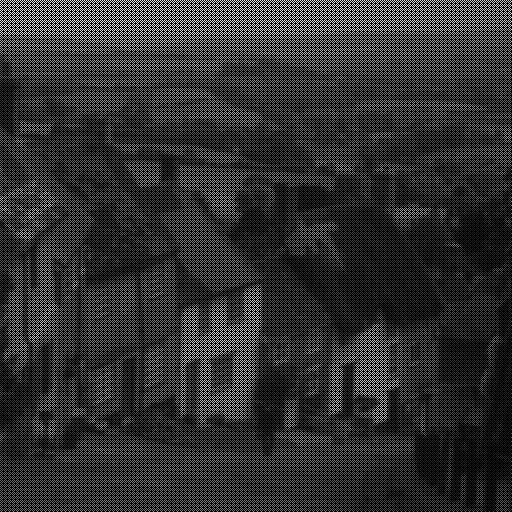

In [ ]:
rows, cols, channels = img.shape
rows_d, cols_d, channels_d = down_sampled_img.shape
resized_img = np.zeros((rows,cols,channels), dtype=img.dtype)

scale = 2

for cha in range(channels_d):
  for row in range(rows_d):
    for col in range(cols_d):
      resized_img[row*scale][col*scale][cha] = down_sampled_img[row][col][cha]

cv2_imshow(resized_img)
# print(f"{resized_img[12,16,0]}")

# for cha in range(channels):
for row in range(rows_d):
  for col in range(cols_d):
    # print(resized_img[row*scale-1,col*scale-1])
    # resized_img[row*scale-1,col*scale-1] = bi_interpolation(resized_img, row*scale-1, col*scale-1)
    # print(resized_img[row*scale-1,col*scale-1])
    if row%2!=0 or col%2!=0:
      interpolated_value = bi_interpolation(resized_img, row*scale-1, col*scale-1)
      resized_img[row*scale-1][col*scale-1] = interpolated_value

# print(f"\nStrethced image without adding Values:\n")
# cv2_imshow(resized_img)

# for cha in range(channels):
#   for row in range(rows):
#     for col in range(cols):
#       j = scale*(row-1) + 1
#       i = scale*(col-1) + 1
#       upsampled_img[j,i] = down_sampled_img[row,col]
#       upsampled_img[j+1,i] = down_sampled_img[row,col]
#       upsampled_img[j,i+1] = down_sampled_img[row,col]
#       upsampled_img[j+1,i+1] = down_sampled_img[row,col]
      # d = NONe
      # resized_img[row][col][cha] = resized_img[row+1][col+1][cha] + resized_img[row+1][col-1][cha] + resized_img[row-1][col+1][cha] +resized_img[row-1][col-1][cha]

print(f"\nUpsampled Image with Interpolation:\n")
cv2_imshow(resized_img)
# print(f"{resized_img[12,16,0]}")



In [ ]:
MSE(img,resized_img)

73620350.0

##1.1.3

In [ ]:
def bitplane(img):
  rows , cols  = img.shape
  planes = []
  for i in range(rows):
    for j in range(cols):
      planes.append(np.binary_repr(img[i][j],width=8))

  return planes

###Decomposing to 8 planes


Plane 0



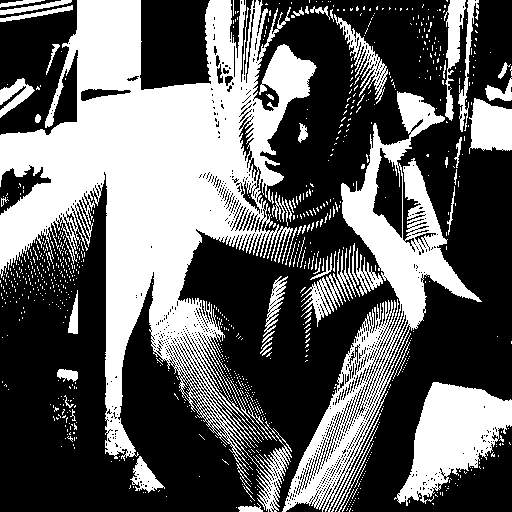


Plane 1



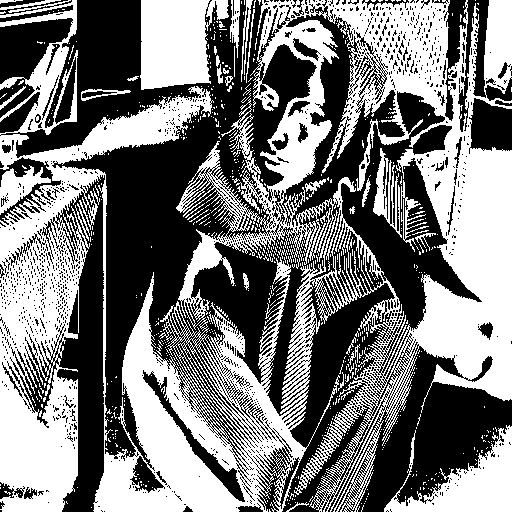


Plane 2



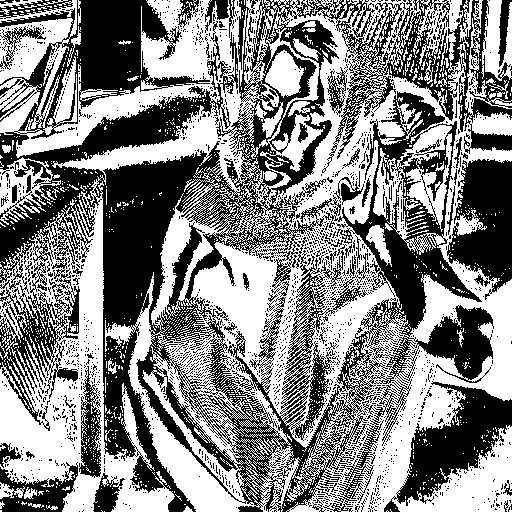


Plane 3



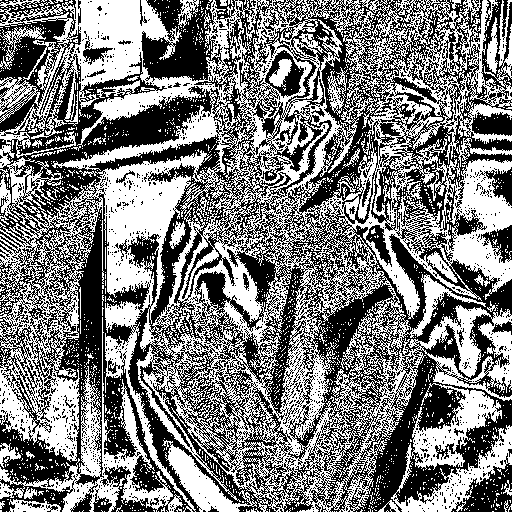


Plane 4



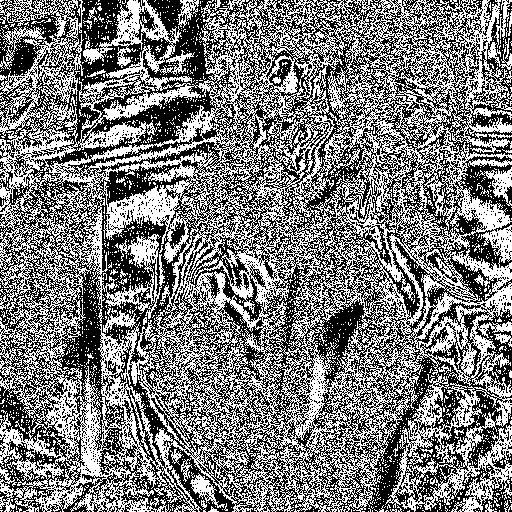


Plane 5



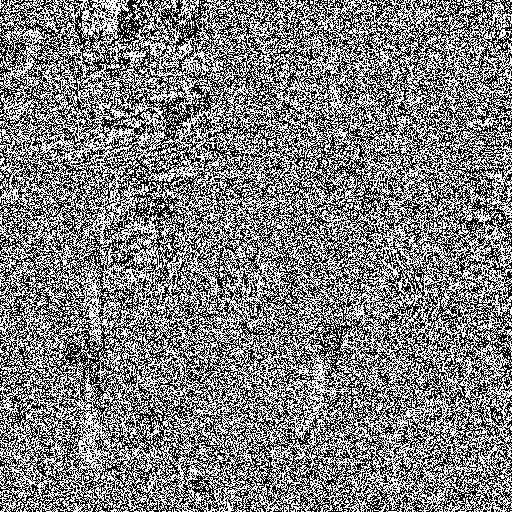


Plane 6



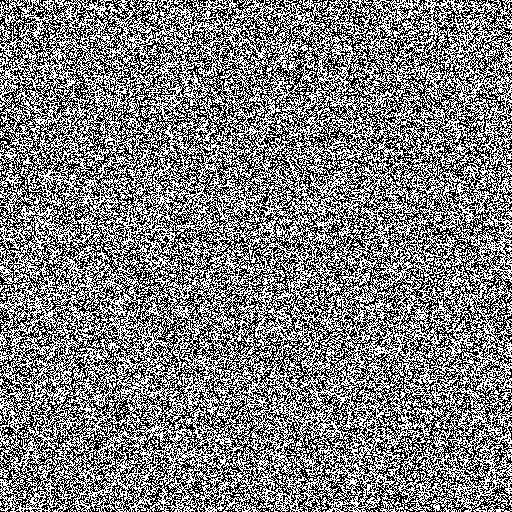


Plane 7



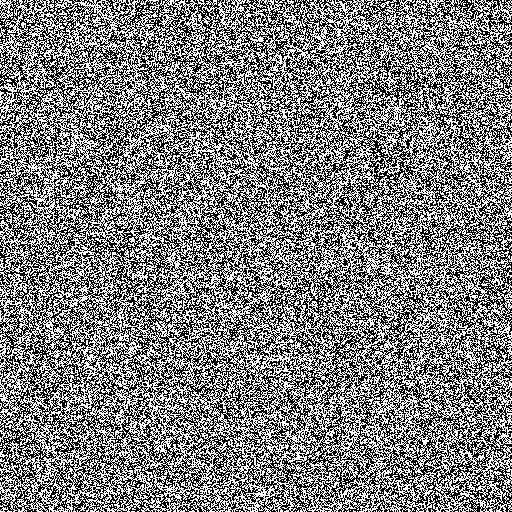

In [ ]:
img = cv2.imread("Barbara.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

bits = np.array(bitplane(img))
bits = bits.reshape(img.shape)

plane = np.zeros((img.shape))
planes = []
for k in range(8):
  for i in range(bits.shape[0]):
    for j in range(bits.shape[1]):
      plane[i,j] = int(bits[i,j][k])
  planes.append(plane*255)

for i in range(len(planes)):
  print(f"\nPlane {i}\n")
  cv2_imshow(planes[i])

###Merge Planes

In [ ]:
#bitwise shift
for p in planes:
  p = p//255
output = [np.zeros(img.shape)for i in range(5)]
  # res5 = np.zeros(img.shape)

for i in range(img.shape[0]):
  for j in range(img.shape[1]):
    output[4][i, j] = (np.int32((np.int64(planes[0][i, j])))|(np.int64(planes[1][i, j]) >> 1)|(np.int64(planes[2][i, j]) >> 2)|(np.int64(planes[3][i, j]) >> 3)|(np.int64(planes[4][i, j]) >> 4)|(np.int64(planes[5][i, j]) >> 5))
    output[3][i, j] = (np.int32((np.int64(planes[0][i, j])))|(np.int64(planes[1][i, j]) >> 1)|(np.int64(planes[2][i, j]) >> 2)|(np.int64(planes[3][i, j]) >> 3)|(np.int64(planes[4][i, j]) >> 4))
    output[2][i, j] = (np.int32((np.int64(planes[0][i, j])))|(np.int64(planes[1][i, j]) >> 1)|(np.int64(planes[2][i, j]) >> 2)|(np.int64(planes[3][i, j]) >> 3))
    output[1][i, j] = (np.int32((np.int64(planes[0][i, j])))|(np.int64(planes[1][i, j]) >> 1)|(np.int64(planes[2][i, j]) >> 2))
    output[0][i, j] = (np.int32((np.int64(planes[0][i, j])))|(np.int64(planes[1][i, j]) >> 1))

*******
n_bit:1
*******


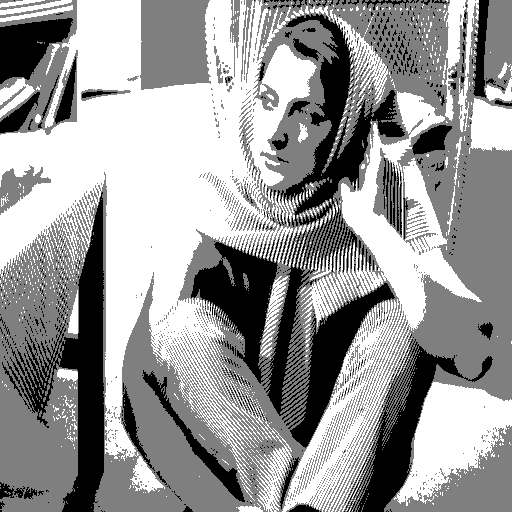

*******
n_bit:2
*******


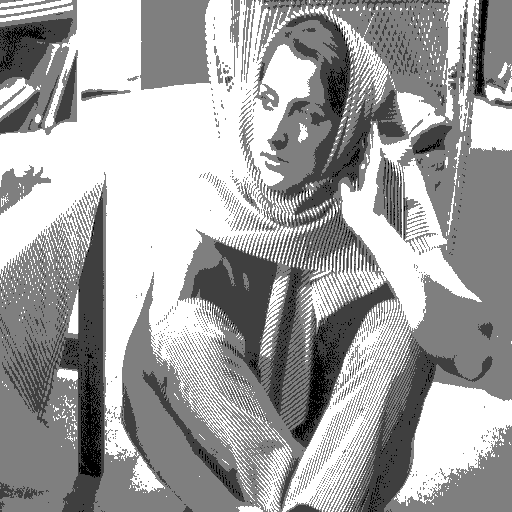

*******
n_bit:3
*******


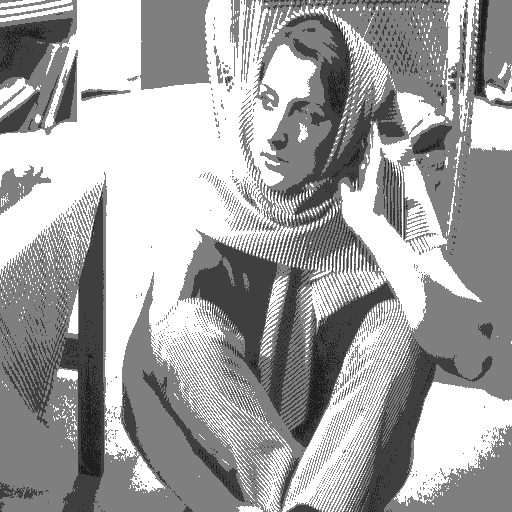

*******
n_bit:4
*******


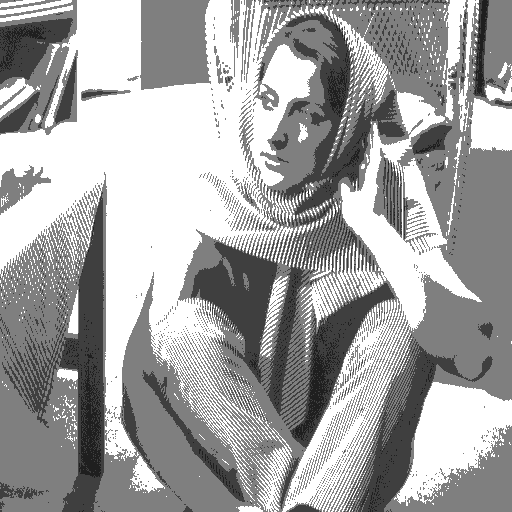

*******
n_bit:5
*******


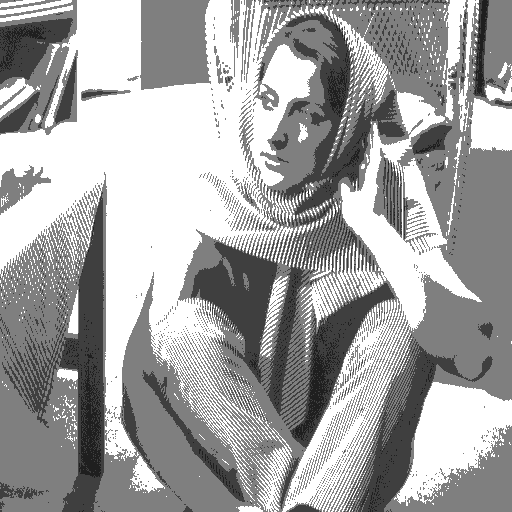

In [ ]:
for i in range(len(output)):
  print(f"*******\nn_bit:{i+1}\n*******")
  cv2_imshow(output[i])

##Contrast Adjustment

##2.1 Histogram Equalization

In [ ]:
def hist_cal(img , g_levels):
  rows , cols = img.shape
  hist = [i for i in range(g_levels)]
  for r in range(rows):
    for c in range(cols):
      hist[img[r,c]]+=1

  return hist

In [ ]:
img = cv2.imread("Camera Man.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

h = hist_cal(img,256)

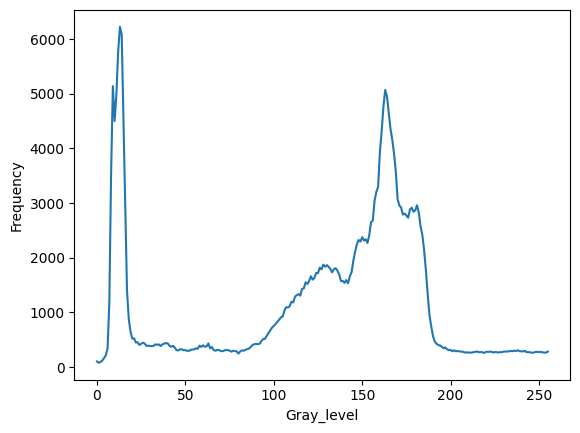

In [ ]:
plt.plot(h)
plt.xlabel('Gray_level')
plt.ylabel('Frequency')
plt.show()

###2.1.1

In [ ]:
# hist,bins = np.histogram(img.flatten(),256,[0,256])

# cdf = hist.cumsum()
# cdf_normalized = cdf * float(hist.max()) / cdf.max()

# plt.plot(cdf_normalized, color = 'b')
# plt.hist(img.flatten(),256,[0,256], color = 'r')
# plt.xlim([0,256])
# plt.legend(('cdf','histogram'), loc = 'upper left')
# plt.show()

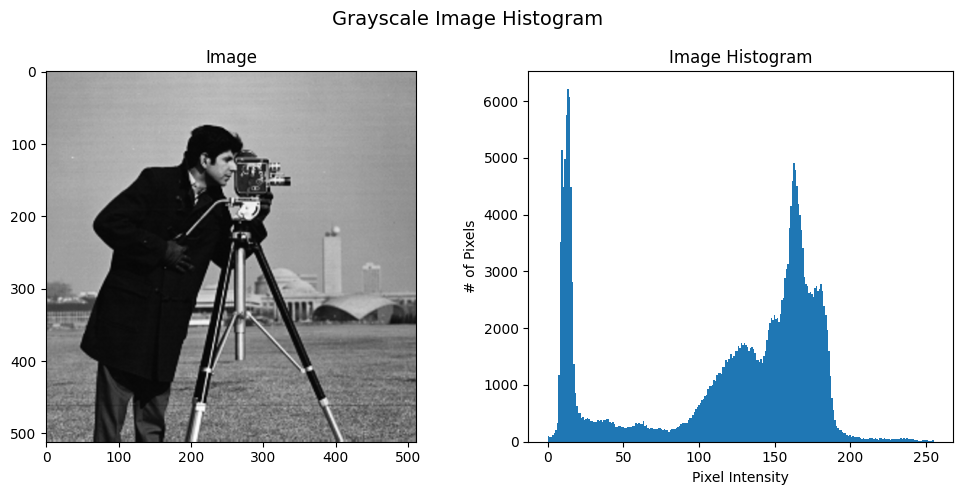

In [ ]:
img = cv2.imread("Camera Man.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

fig, axs = plt.subplots(1, 2 , figsize=(10,5))
fig.suptitle("Grayscale Image Histogram", fontsize=14)

axs[0].imshow(img, cmap='gray')
axs[0].set_title(f"Image", fontsize=12)

axs[1].hist(img.ravel(),bins=256,range=(0,255))
axs[1].set_title('Image Histogram')
axs[1].set_xlabel('Pixel Intensity')
axs[1].set_ylabel('# of Pixels')

plt.tight_layout()
plt.show()

# hist = np.histogram()

####2.1.1.1

In [ ]:
D = img//3

####2.1.1.2

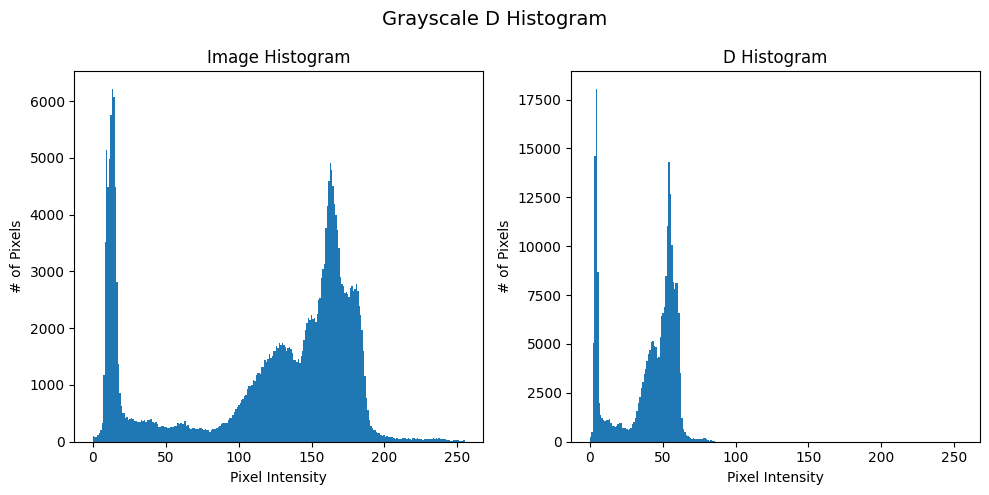

In [ ]:
fig, axs = plt.subplots(1, 2 , figsize=(10,5))
fig.suptitle("Grayscale D Histogram", fontsize=14)

axs[0].hist(img.ravel(),bins=256,range=(0,255))
axs[0].set_title('Image Histogram')
axs[0].set_xlabel('Pixel Intensity')
axs[0].set_ylabel('# of Pixels')

axs[1].hist(D.ravel(),bins=256,range=(0,255))
axs[1].set_title('D Histogram')
axs[1].set_xlabel('Pixel Intensity')
axs[1].set_ylabel('# of Pixels')

plt.tight_layout()
plt.show()

####2.1.1.3

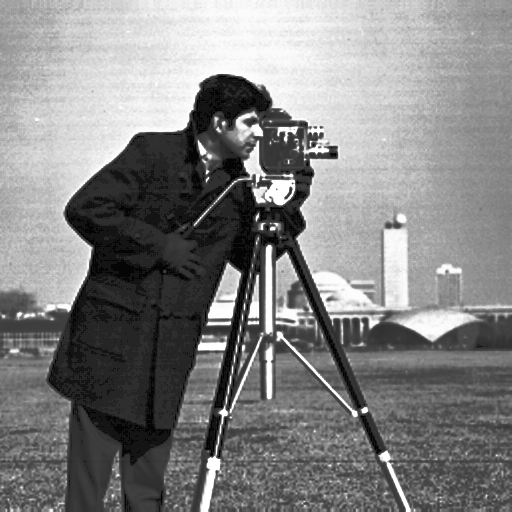

In [ ]:
H = cv2.equalizeHist(D)
cv2_imshow(H)

####2.1.1.4

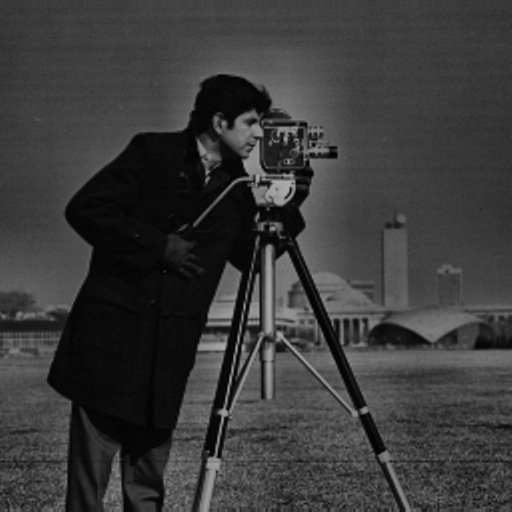

In [ ]:
#Contrast Limited Adaptive Histogram Equalization
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
L = clahe.apply(D)
cv2_imshow(L)

####2.1.1.5

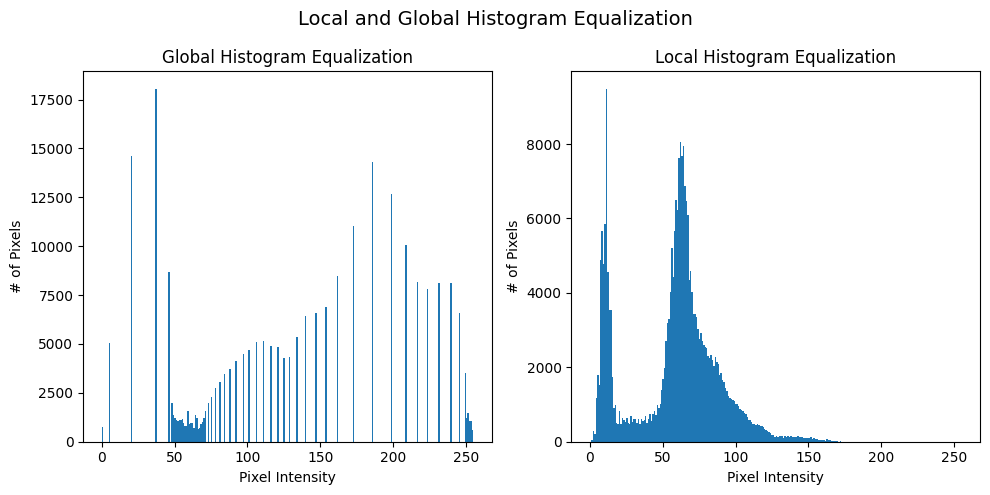

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(10,5))
fig.suptitle("Local and Global Histogram Equalization", fontsize=14)

axs[0].hist(H.ravel(),bins=256,range=(0,255))
axs[0].set_title('Global Histogram Equalization')
axs[0].set_xlabel('Pixel Intensity')
axs[0].set_ylabel('# of Pixels')

axs[1].hist(L.ravel(),bins=256,range=(0,255))
axs[1].set_title('Local Histogram Equalization')
axs[1].set_xlabel('Pixel Intensity')
axs[1].set_ylabel('# of Pixels')

plt.tight_layout()
plt.show()

مشاهده میکنیم که تغییرات لوکال به نسبت گلوبال نرم تر و نامحسوس تر است در نتیجه کیفیت تصویر بهتر است.

####2.1.1.6

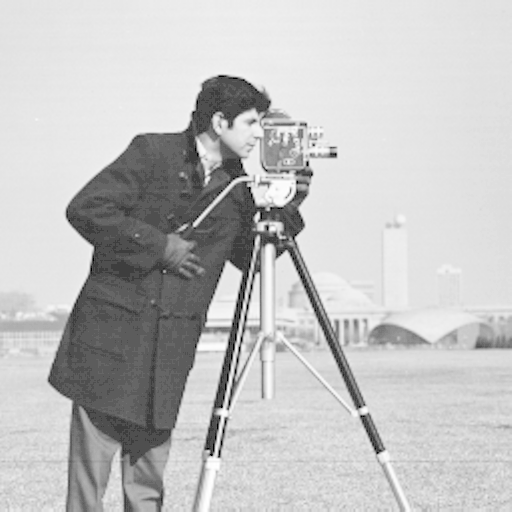

In [ ]:
lt_d = D.copy()

#مقدار بهینه ضریب با توجه به تعداد بیت استفاده شده
c = 255 / np.log(1 + np.max(lt_d))
lt_d = c * (np.log(lt_d + 1))

#استفاده از توابع آماده
# cv2.intensity_transform.logTransform(D,lt_d)

cv2_imshow(lt_d)

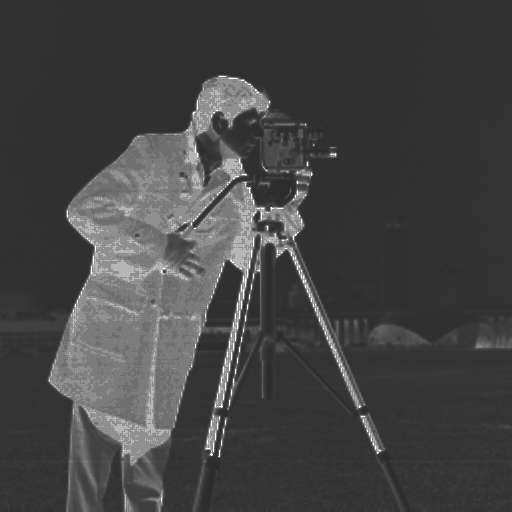

In [ ]:
ilt_d = D.copy()

#مقدار بهینه ضریب با توجه به تعداد بیت استفاده شده
# c = 255 / np.log(1 + np.max(ilt_d))
c = 200
# ilt_d = c * (np.log(np.float64((ilt_d + 1))**(-1)))
ilt_d = c * (np.log(ilt_d + 1+0.0000000001)**(-1))

cv2_imshow(ilt_d)

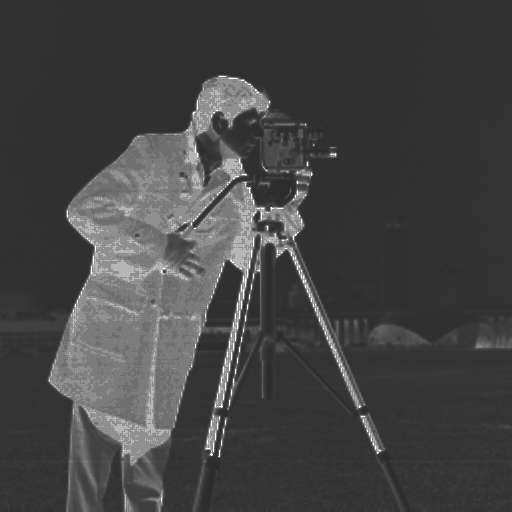

In [ ]:
#?
ilt_d = D.copy()

c = 200
for row in range(512):
  for col in range(512):
    z = c * (np.log(ilt_d[row,col] + 1+0.0000000001)**(-1))
    if z<0:ilt_d[row,col]=0
    elif z>255:ilt_d[row,col]=255
    else:ilt_d[row,col]=z

cv2_imshow(ilt_d)

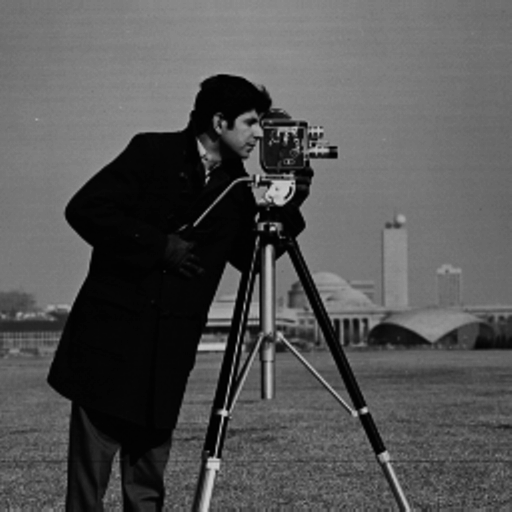

In [ ]:
pl_d = D.copy()

c = 1
gama = 1.2

pl_d = c * (pl_d**gama)

cv2_imshow(pl_d)

###2.1.2

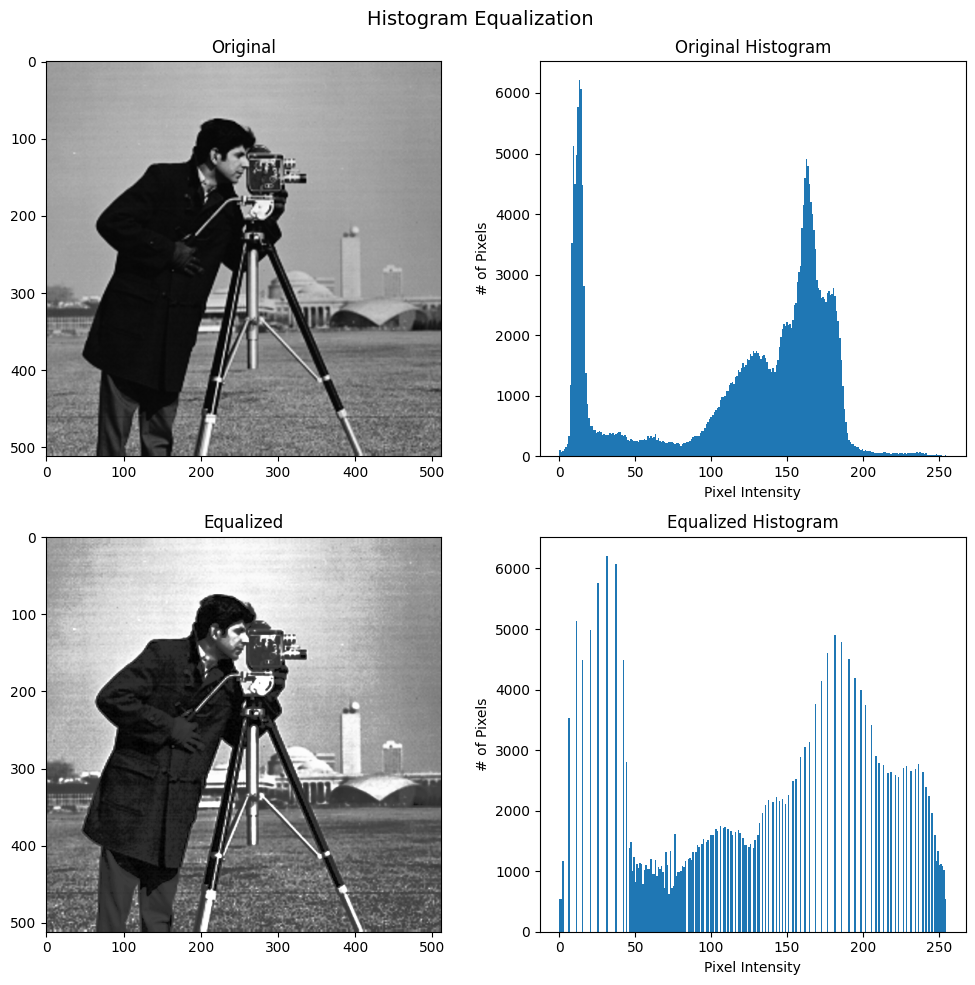

In [ ]:
img = cv2.imread("Camera Man.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

eq_img = cv2.equalizeHist(img)

fig, axs = plt.subplots(2,2 , figsize=(10,10))
fig.suptitle("Histogram Equalization", fontsize=14)

axs[0,0].imshow(img, cmap='gray')
axs[0,0].set_title(f"Original", fontsize=12)

axs[0,1].hist(img.ravel(),bins=256,range=(0,255))
axs[0,1].set_title('Original Histogram')
axs[0,1].set_xlabel('Pixel Intensity')
axs[0,1].set_ylabel('# of Pixels')

axs[1,0].imshow(eq_img, cmap='gray')
axs[1,0].set_title(f"Equalized", fontsize=12)

axs[1,1].hist(eq_img.ravel(),bins=256,range=(0,255))
axs[1,1].set_title('Equalized Histogram')
axs[1,1].set_xlabel('Pixel Intensity')
axs[1,1].set_ylabel('# of Pixels')

plt.tight_layout()
plt.show()

# hist = np.histogram()

##2.2

###2.2.1

In [ ]:
HE1 = cv2.cvtColor(cv2.imread('HE1.jpg'),cv2.COLOR_BGR2GRAY)
HE2 = cv2.cvtColor(cv2.imread('HE2.jpg'),cv2.COLOR_BGR2GRAY)
HE3 = cv2.cvtColor(cv2.imread('HE3.jpg'),cv2.COLOR_BGR2GRAY)
HE4 = cv2.cvtColor(cv2.imread('HE4.jpg'),cv2.COLOR_BGR2GRAY)
pics = [HE1,HE2,HE3,HE4]
Eq4 = [None for i in range(len(pics))]
Eq8 = [None for i in range(len(pics))]
Eq16 = [None for i in range(len(pics))]
Eq_g =[None for i in range(len(pics))]


clahe4 = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(4,4))
clahe8 = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

for i in range(len(pics)):
  Eq4[i] = clahe4.apply(pics[i])
  Eq8[i] = clahe8.apply(pics[i])
  Eq_g[i] = cv2.equalizeHist(pics[i])

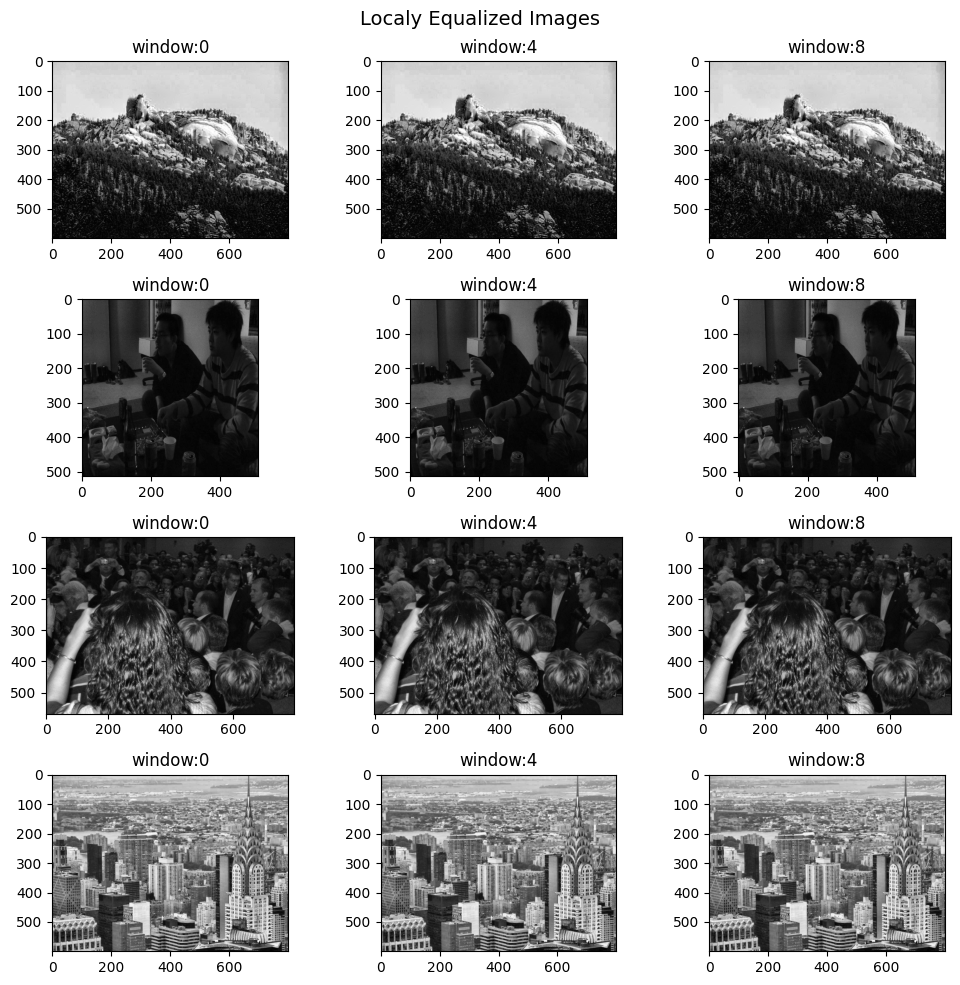

In [ ]:
fig, axs = plt.subplots(4, 3, figsize=(10,10))
fig.suptitle("Localy Equalized Images", fontsize=14)

merge = pics + Eq4 + Eq8

for j in range(3):
  for i in range(0,len(merge)):
    axs[i%4,j].imshow(merge[i], cmap='gray')
    axs[i%4,j].set_title(f"window:{j*4}", fontsize=12)


plt.tight_layout()
plt.show()

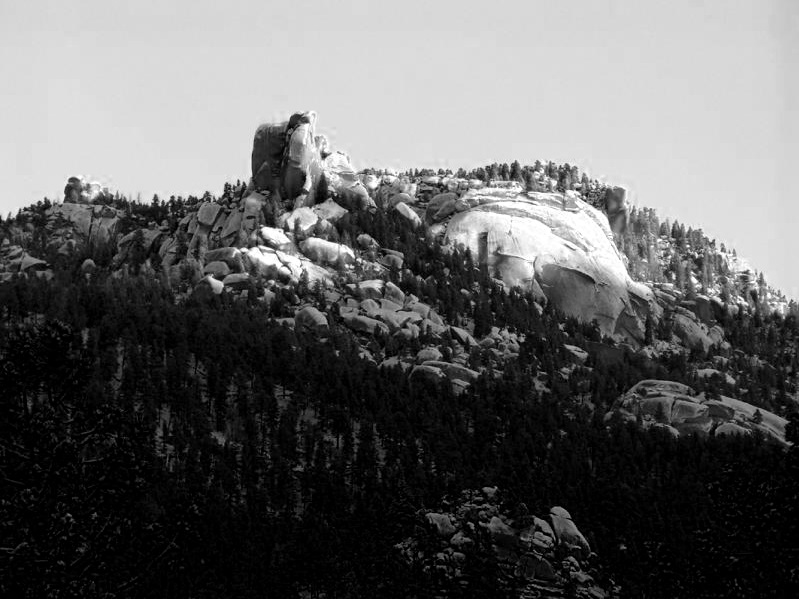

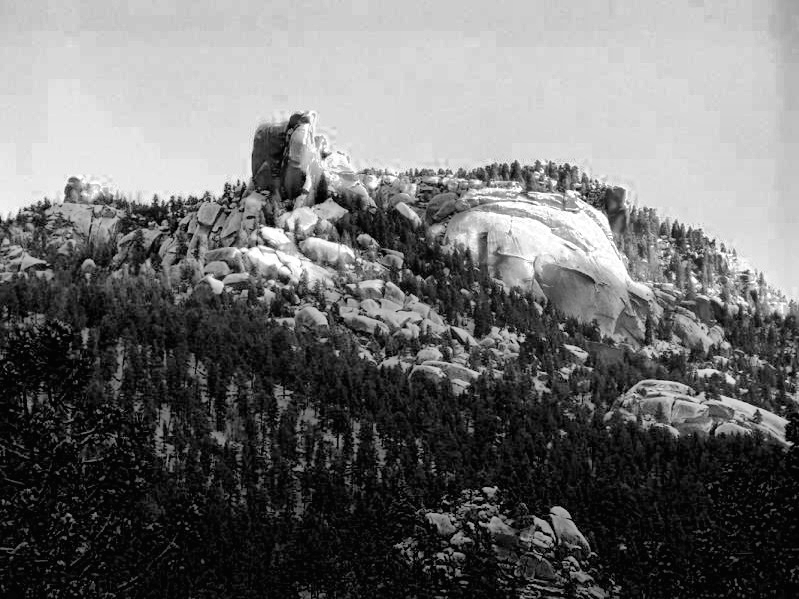

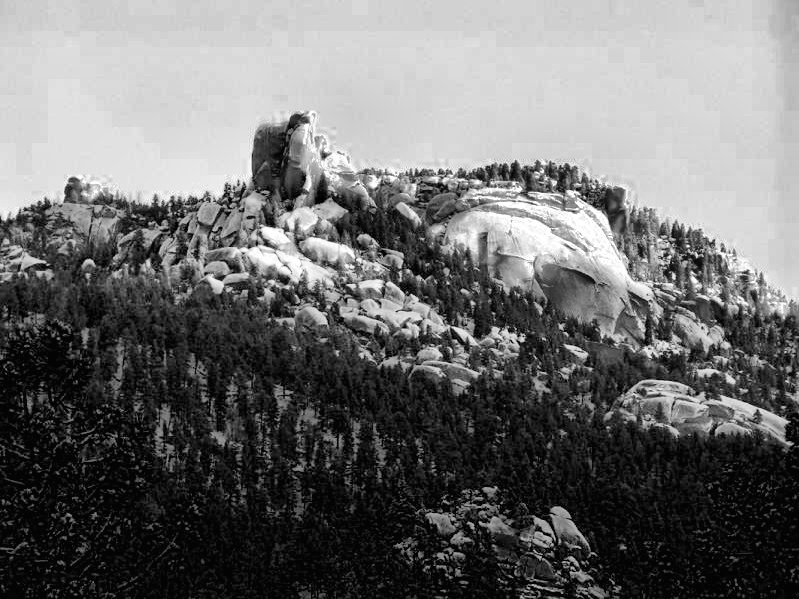

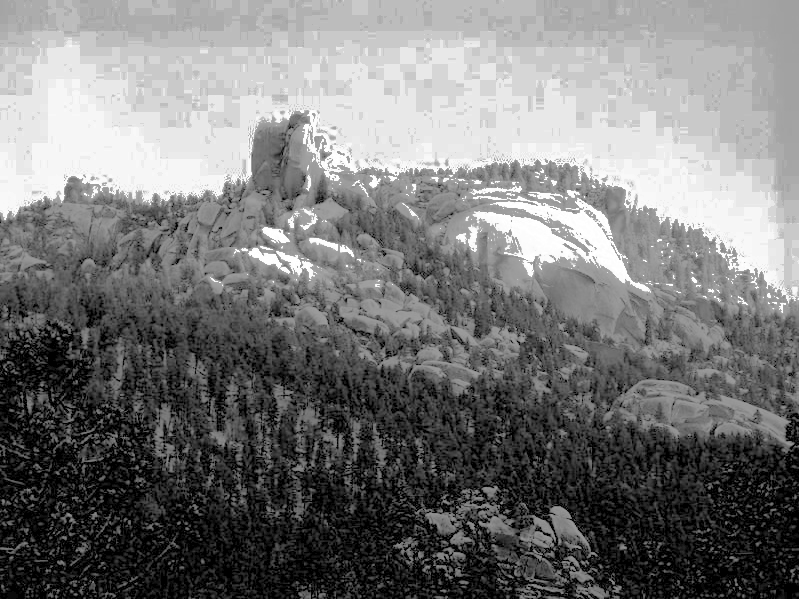

In [ ]:
cv2_imshow(merge[0])
cv2_imshow(merge[4])
cv2_imshow(merge[8])
cv2_imshow(Eq_g[0])

#Filters

##3.1

###3.1.1

###3.1.2

###3.1.3

In [168]:
def filter(img, n, filter):
  rows , cols = img.shape

  img = cv2.copyMakeBorder(img,n-1,n-1,n-1,n-1,cv2.BORDER_REFLECT_101)

  for r in range(rows):
    for c in range(cols):
      window = img[r:r+n,c:c+n]
      img[r,c] = np.sum(window*filter)

  return img

In [ ]:
def boxfilter(img):
  rows , cols = img.shape
  for r in range(rows-1):
    for c in range(cols-1):
      img[r,c] = ((1/9)*img[r,c]) + ((1/9)*img[r+1,c]) + ((1/9)*img[r,c+1]) + ((1/9)*img[r+1,c+1]) + ((1/9)*img[r-1,c-1]) + ((1/9)*img[r-1,c]) + ((1/9)*img[r,c-1]) + ((1/9)*img[r-1,c+1]) + ((1/9)*img[r+1,c-1])
  return img

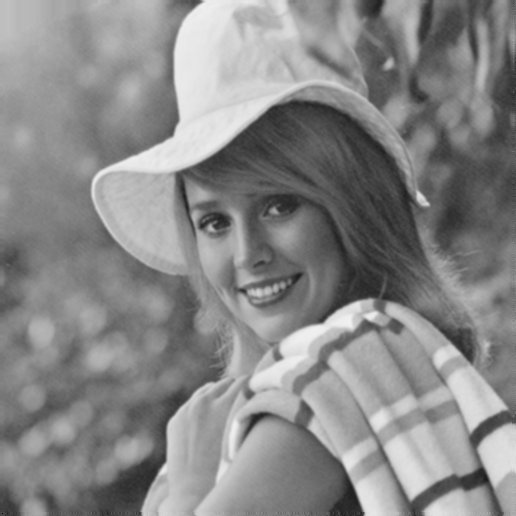

In [ ]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

rows , cols = img.shape

n = 3

img = cv2.copyMakeBorder(img,n-1,n-1,n-1,n-1,cv2.BORDER_REFLECT_101)

filter = [[1/(n**2) for i in range(n)] for j in range(n)]

for r in range(rows):
  for c in range(cols):
    window = img[r:r+n,c:c+n]
    # print(f"***\n{window}\n***")
    img[r,c] = np.sum(window*filter)
    # img[r,c] +=

cv2_imshow(np.array(img))

In [ ]:
def apply_bf(img,num,n,f):
  bf = img.copy()
  for i in range(num):
    bf = filter(bf,n,f)

  return bf

In [ ]:
# def boxfilter(img, filter_size):
#   fs = int(np.floor(np.sqrt(filter_size)/2))
#   print(f"filter_size:{filter_size} , fs:{fs}")
#   rows , cols = img.shape
#   for r in range(rows-1):
#     for c in range(cols-1):
#       for f1 in range(-fs,fs+1):
#         for f2 in range(-fs,fs+1):
#           img[r,c] += (1/filter_size) * img[r+f1,c+f2]
#   return img

Text(0.5, 1.0, '10 time boxfilter')

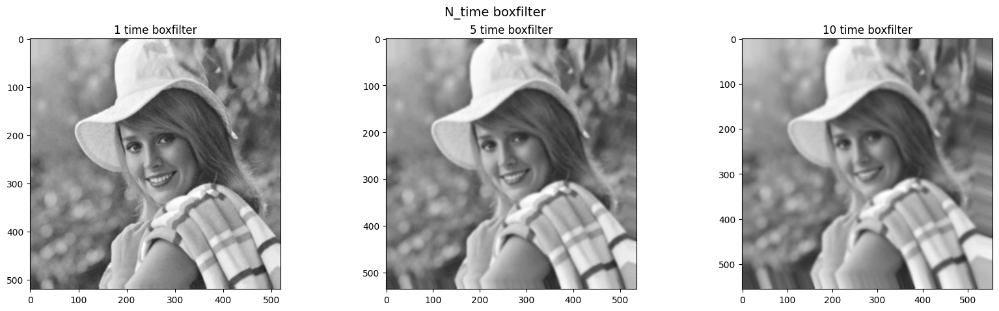

In [ ]:
img = cv2.imread('Elaine.bmp')
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

#ADD Reflect Padding
img = cv2.copyMakeBorder(img,2,2,2,2,cv2.BORDER_REFLECT_101)

#apply boxfilter n times
# n = 1
# for i in range(n):
#   img = boxfilter(img)

n=3
f_33 = [[1/(n**2) for i in range(n)] for j in range(n)]

bf_1 = apply_bf(img,1,3,f_33)
bf_5 = apply_bf(img,5,3,f_33)
bf_10 = apply_bf(img,10,3,f_33)

fig, axs = plt.subplots(1,3 , figsize=(20,5))
fig.suptitle("N_time boxfilter", fontsize=14)

axs[0].imshow(bf_1, cmap='gray')
axs[0].set_title(f"1 time boxfilter", fontsize=12)

axs[1].imshow(bf_5, cmap='gray')
axs[1].set_title(f"5 time boxfilter", fontsize=12)

axs[2].imshow(bf_10, cmap='gray')
axs[2].set_title(f"10 time boxfilter", fontsize=12)

###3.1.4

Text(0.5, 1.0, '7*7 boxfilter')

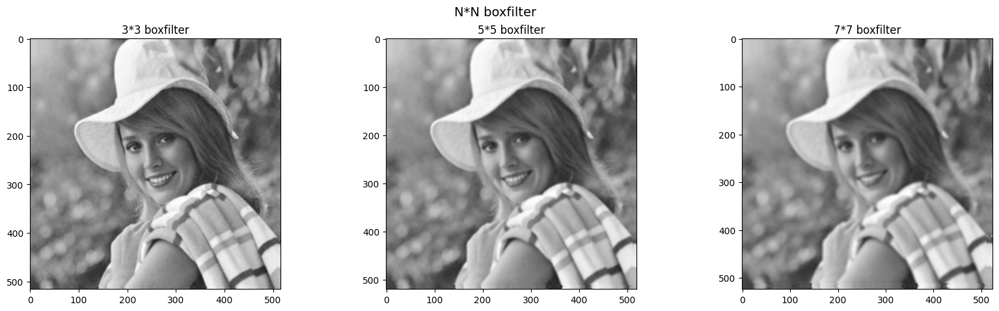

In [ ]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

n=3
f_33 = [[1/(n**2) for i in range(n)] for j in range(n)]
n=5
f_55 = [[1/(n**2) for i in range(n)] for j in range(n)]
n=7
f_77 = [[1/(n**2) for i in range(n)] for j in range(n)]


bf_33=filter(img,3,f_33)
bf_55=filter(img,5,f_55)
bf_77=filter(img,7,f_77)

fig, axs = plt.subplots(1,3 , figsize=(20,5))
fig.suptitle("N*N boxfilter", fontsize=14)

axs[0].imshow(bf_33, cmap='gray')
axs[0].set_title(f"3*3 boxfilter", fontsize=12)

axs[1].imshow(bf_55, cmap='gray')
axs[1].set_title(f"5*5 boxfilter", fontsize=12)

axs[2].imshow(bf_77, cmap='gray')
axs[2].set_title(f"7*7 boxfilter", fontsize=12)

###3.1.6

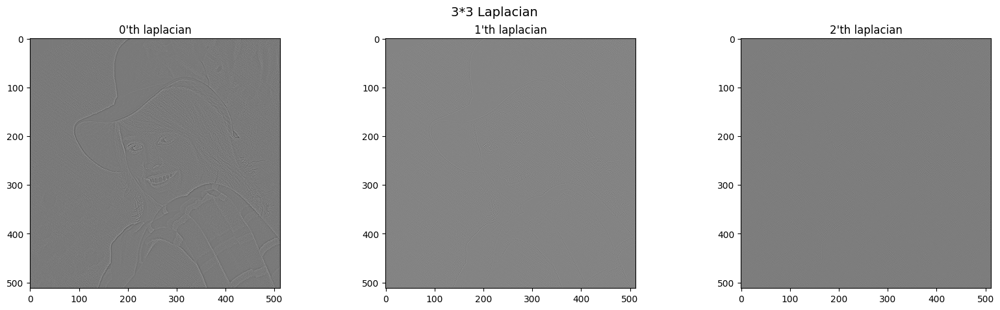

In [ ]:
#?
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

laplacian_mask = [[0,-1,0],[-1,5,-1],[0,-1,0]]
# laplacian_mask = [[-1,-1,-1],[-1,9,-1],[-1,-1,-1]]

masked_img = img.copy()
l = []

for i in range(3):
  # masked_img = filter(masked_img,3,laplacian_mask)
  masked_img = cv2.Laplacian(masked_img , 3)
  l.append(masked_img)

fig, axs = plt.subplots(1,len(l) , figsize=(20,5))
fig.suptitle("3*3 Laplacian", fontsize=14)

for i in range(0,len(l)):
  axs[i].imshow(l[i], cmap='gray')
  axs[i].set_title(f"{i}'th laplacian", fontsize=12)

##3.2

###3.2.1


********************************
noisy image:1 , density-level:1
********************************


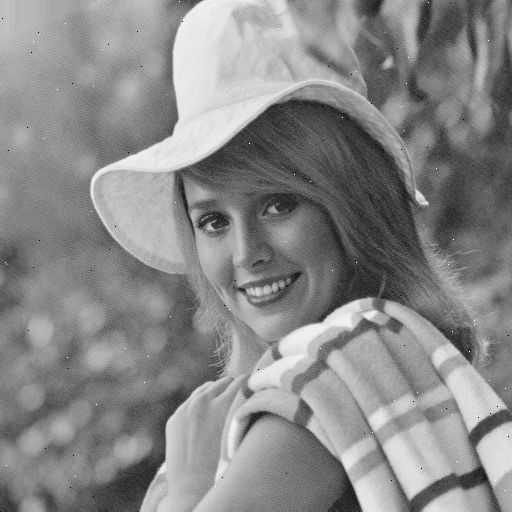


********************************
noisy image:2 , density-level:2
********************************


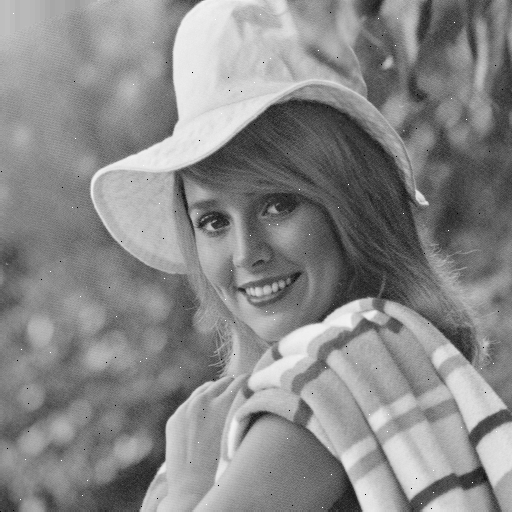


********************************
noisy image:3 , density-level:3
********************************


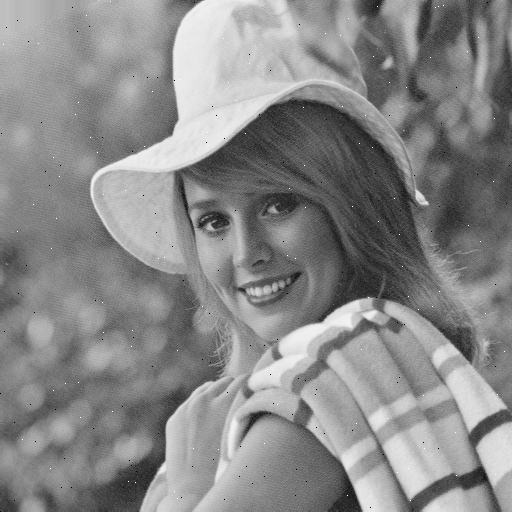


********************************
noisy image:4 , density-level:4
********************************


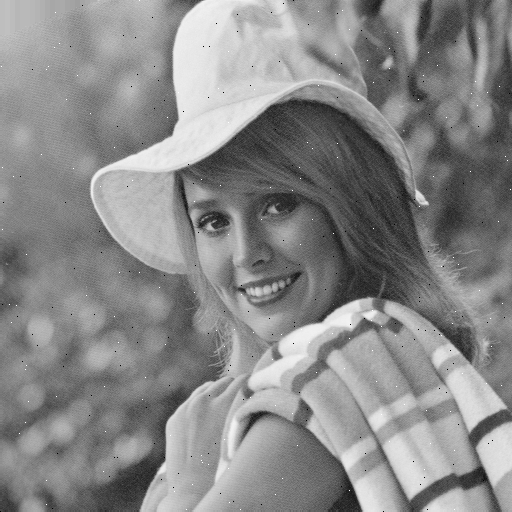


********************************
noisy image:5 , density-level:5
********************************


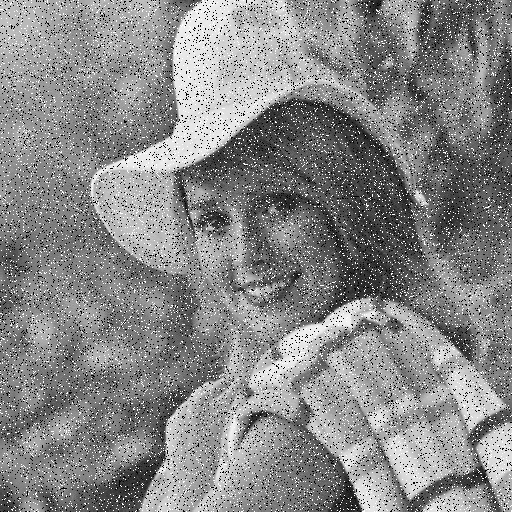

In [ ]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

#add salt and pepper noise
rows,cols = img.shape

density = [np.sqrt(0.05),np.sqrt(0.1),np.sqrt(0.2),np.sqrt(0.4),70]
noisy_img = [(img.copy()) for i in range(5)]

for n in range(len(noisy_img)):

  pixel_rows = np.random.randint(0,rows,int(density[n]*rows))
  pixel_cols = np.random.randint(0,cols,int(density[n]*cols))

  salt_and_pepper = np.random.randint(0,2,len(pixel_rows))

  for i in range(len(pixel_rows)):
      value = salt_and_pepper[i]*255
      noisy_img[n][pixel_rows[i],pixel_cols[i]] = value

  print(f"\n********************************\nnoisy image:{n+1} , density-level:{n+1}\n********************************")
  cv2_imshow(noisy_img[n])



In [7]:
def median(img,n):
  rows , cols = img.shape

  img = cv2.copyMakeBorder(img,n-1,n-1,n-1,n-1,cv2.BORDER_REFLECT_101)

  # filter = [[1/(n**2) for i in range(n)] for j in range(n)]

  #-N+1
  for r in range(rows):
    for c in range(cols):
      window = img[r:r+n,c:c+n]
      l = list(set(window.flatten()))
      l.sort()
      img[r,c] = l[int(len(l)//2)]
  return img

In [ ]:
##apply median filter on noisy images
fs = [3,5,7,9]
for j in range(len(fs)):
  median_imgs = noisy_img
  for i in range(len(median_imgs)) :
    median_imgs[i] = median(median_imgs[i],fs[j])
    print(f"\n********************************\nmedian image:{i+1} , filter size:{fs[j]} , MSE ={MSE(median_imgs[i],noisy_img[i])}\n********************************")
    cv2_imshow(median_imgs[i])

In [ ]:
def padding(img,fs):
  img_copy = deepcopy(img)
  for i in range(len(img_copy)):
    img_copy[i] = cv2.copyMakeBorder(img_copy[i],fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
  return img_copy


********************************
median image:1 , filter size:3 , MSE =105.61830139160156
********************************


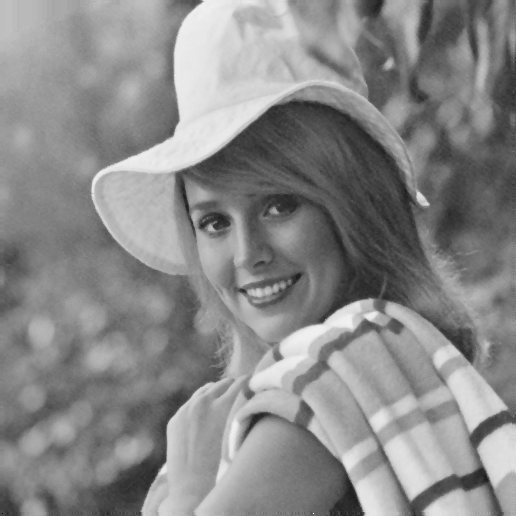


********************************
median image:2 , filter size:3 , MSE =108.74080657958984
********************************


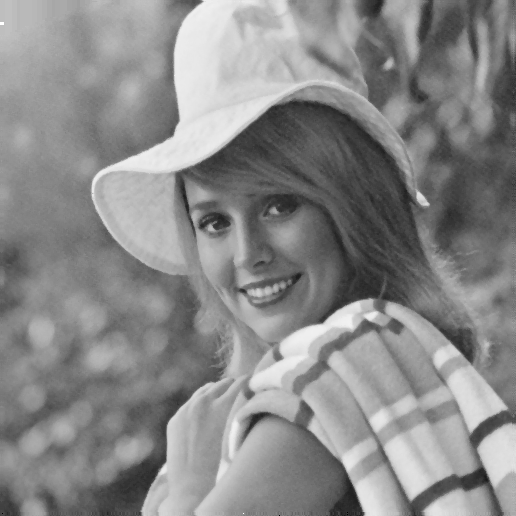


********************************
median image:3 , filter size:3 , MSE =113.2142333984375
********************************


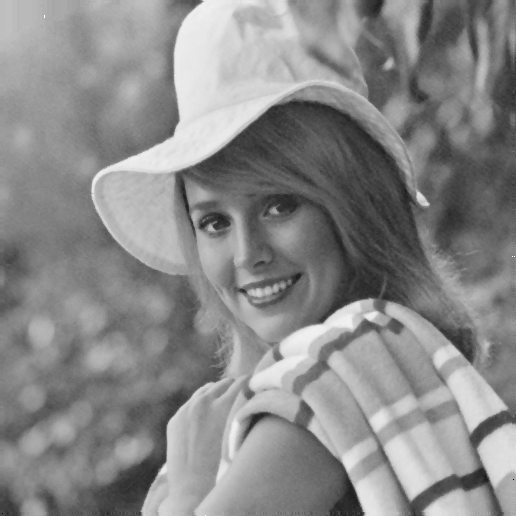


********************************
median image:4 , filter size:3 , MSE =119.02085876464844
********************************


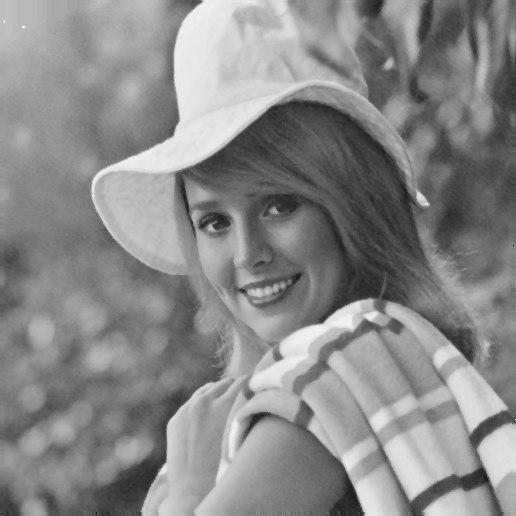


********************************
median image:5 , filter size:3 , MSE =2384.763671875
********************************


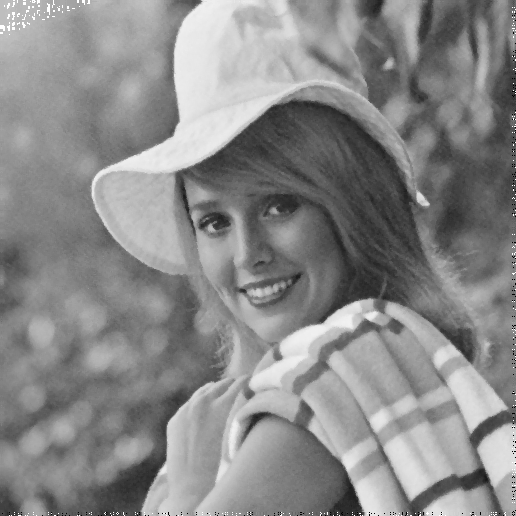

In [ ]:
##apply median filter on noisy images filter 3*3
fs = 3
noisy_img_padded_3 = padding(noisy_img,fs)

median_imgs = deepcopy(noisy_img)
for i in range(len(median_imgs)) :
  median_imgs[i] = median(median_imgs[i],fs)
  print(f"\n********************************\nmedian image:{i+1} , filter size:{fs} , MSE ={MSE(median_imgs[i],noisy_img_padded_3[i])}\n********************************")
  cv2_imshow(median_imgs[i])


********************************
median image:1 , filter size:5 , MSE =217.41404724121094
********************************


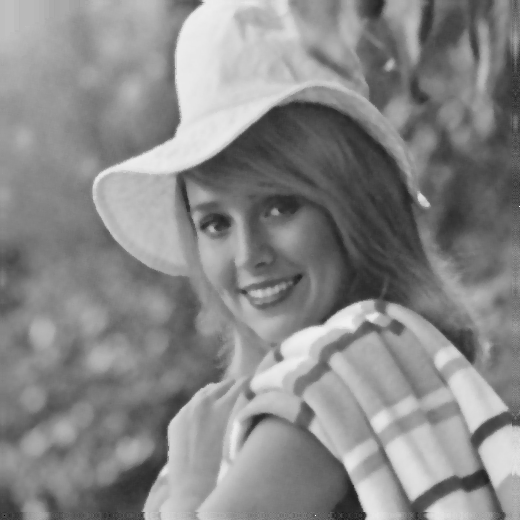


********************************
median image:2 , filter size:5 , MSE =220.81626892089844
********************************


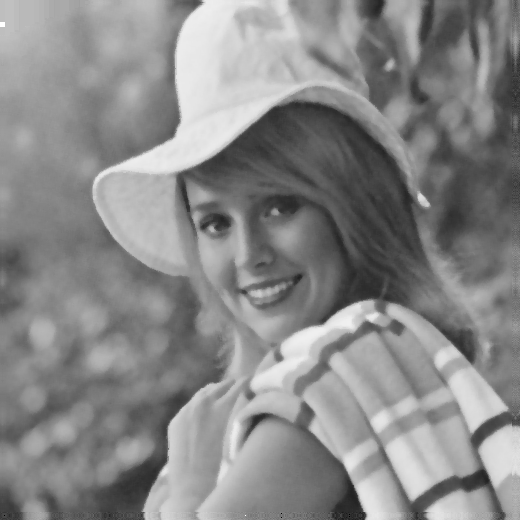


********************************
median image:3 , filter size:5 , MSE =224.9966278076172
********************************


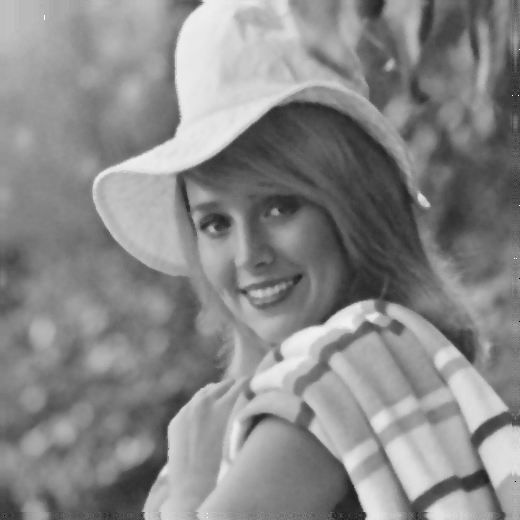


********************************
median image:4 , filter size:5 , MSE =230.7011260986328
********************************


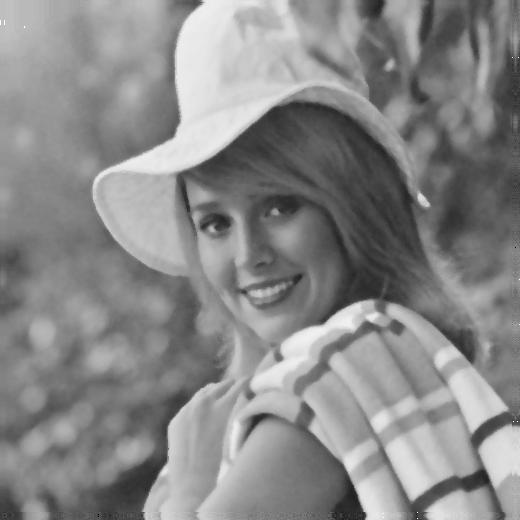


********************************
median image:5 , filter size:5 , MSE =2457.7177734375
********************************


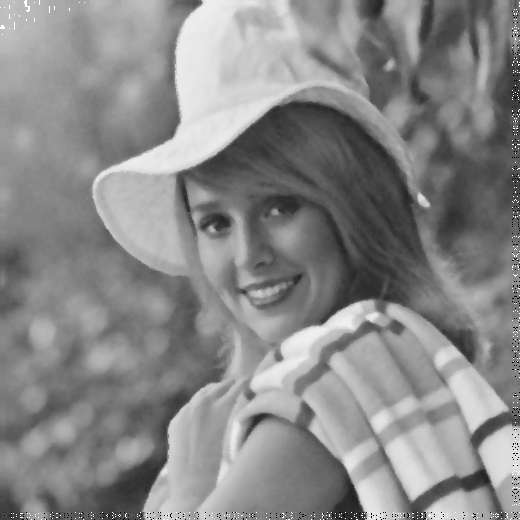

In [ ]:
##apply median filter on noisy images filter 5*5
fs = 5
noisy_img_padded_5 = padding(noisy_img,fs)

median_imgs = deepcopy(noisy_img)
for i in range(len(median_imgs)) :
  median_imgs[i] = median(median_imgs[i],fs)
  print(f"\n********************************\nmedian image:{i+1} , filter size:{fs} , MSE ={MSE(median_imgs[i],noisy_img_padded_5[i])}\n********************************")
  cv2_imshow(median_imgs[i])


********************************
median image:1 , filter size:7 , MSE =325.8828125
********************************


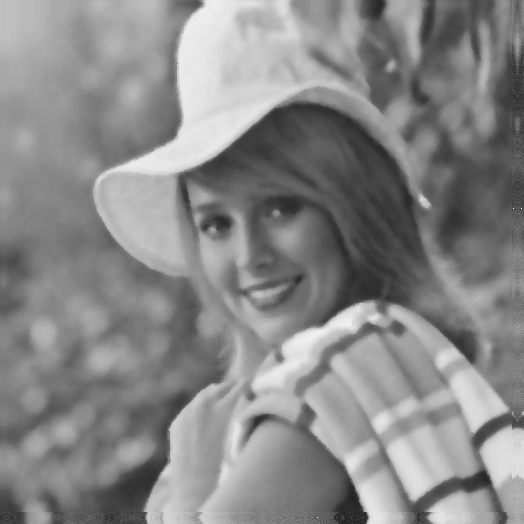


********************************
median image:2 , filter size:7 , MSE =329.0936279296875
********************************


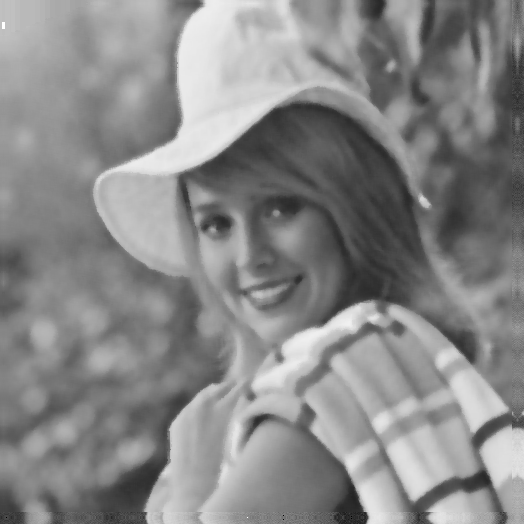


********************************
median image:3 , filter size:7 , MSE =332.7403564453125
********************************


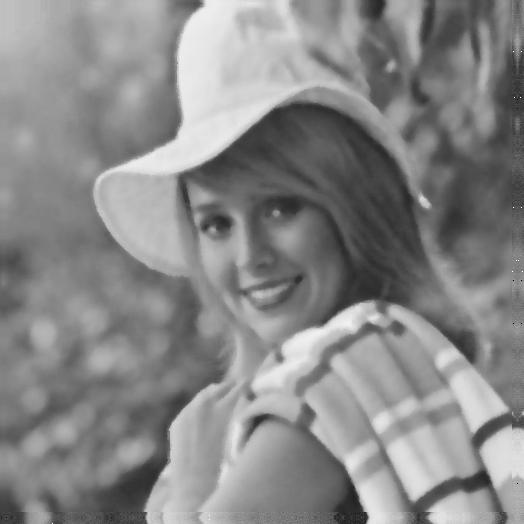


********************************
median image:4 , filter size:7 , MSE =338.6858215332031
********************************


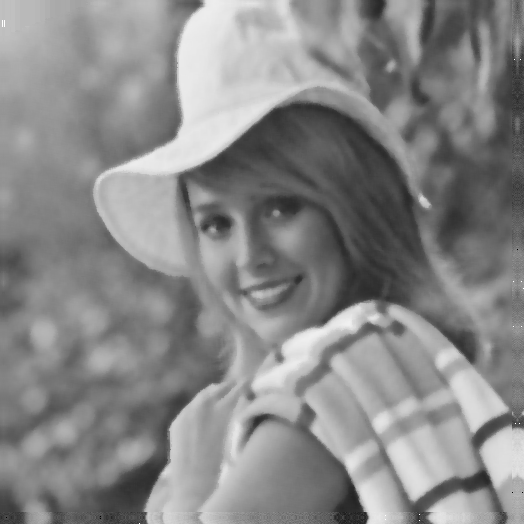


********************************
median image:5 , filter size:7 , MSE =2516.610107421875
********************************


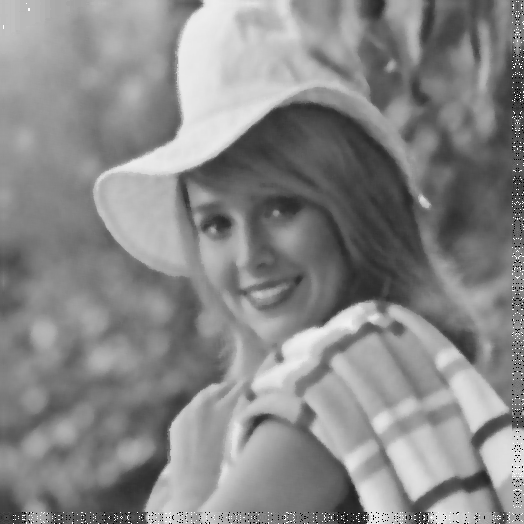

In [ ]:
##apply median filter on noisy images filter 7*7
fs = 7
noisy_img_padded_7 = padding(noisy_img,fs)

median_imgs = deepcopy(noisy_img)
for i in range(len(median_imgs)) :
  median_imgs[i] = median(median_imgs[i],fs)
  print(f"\n********************************\nmedian image:{i+1} , filter size:{fs} , MSE ={MSE(median_imgs[i],noisy_img_padded_7[i])}\n********************************")
  cv2_imshow(median_imgs[i])


********************************
median image:1 , filter size:9 , MSE =421.8804016113281
********************************


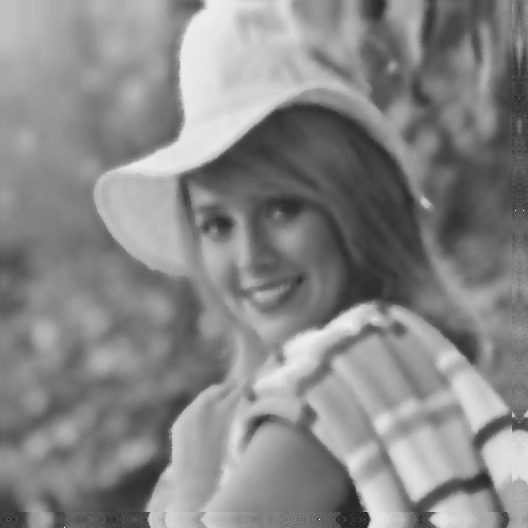


********************************
median image:2 , filter size:9 , MSE =424.8988037109375
********************************


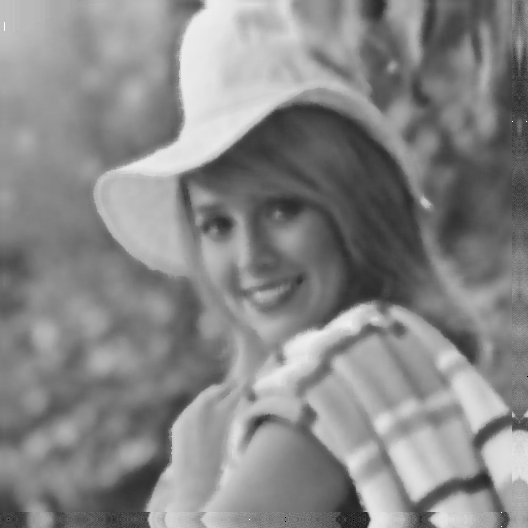


********************************
median image:3 , filter size:9 , MSE =428.85406494140625
********************************


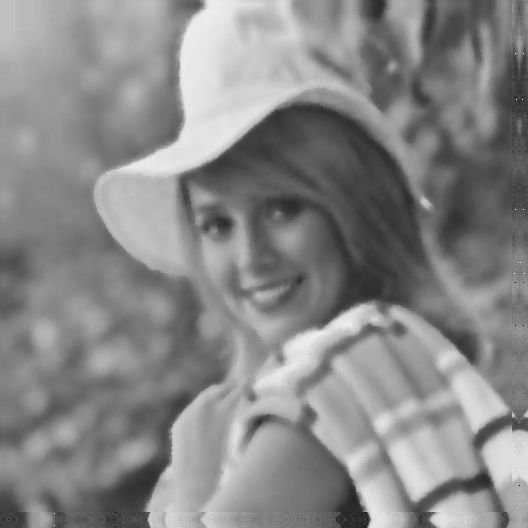


********************************
median image:4 , filter size:9 , MSE =434.279296875
********************************


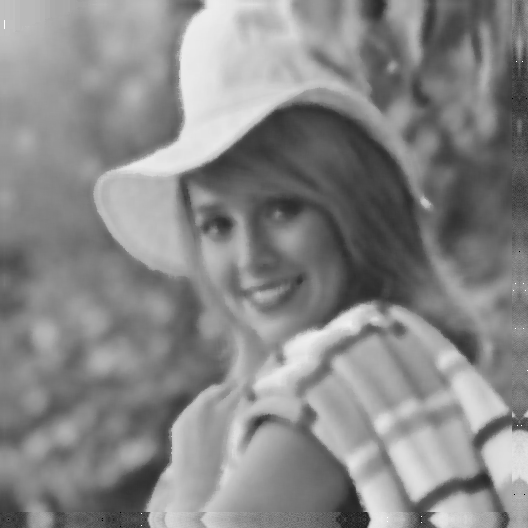


********************************
median image:5 , filter size:9 , MSE =2557.64794921875
********************************


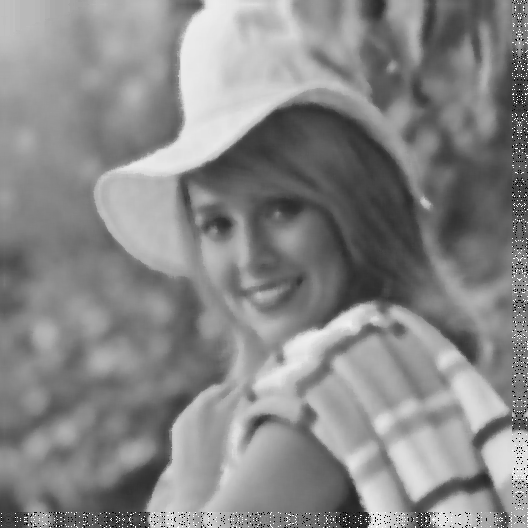

In [ ]:
##apply median filter on noisy images filter 5*5
fs = 9
noisy_img_padded_9 = padding(noisy_img,fs)

median_imgs = deepcopy(noisy_img)
for i in range(len(median_imgs)) :
  median_imgs[i] = median(median_imgs[i],fs)
  print(f"\n********************************\nmedian image:{i+1} , filter size:{fs} , MSE ={MSE(median_imgs[i],noisy_img_padded_9[i])}\n********************************")
  cv2_imshow(median_imgs[i])

###3.2.2

In [8]:
def guassian_noise(img,sigma):
  guassian_noise = np.random.normal(loc=0.0,scale = sigma, size=img.shape)
  noisy_img = np.clip(img + guassian_noise, 0, 255).astype('uint8')
  return noisy_img

Text(0.5, 1.0, 'guassian_filter_img')

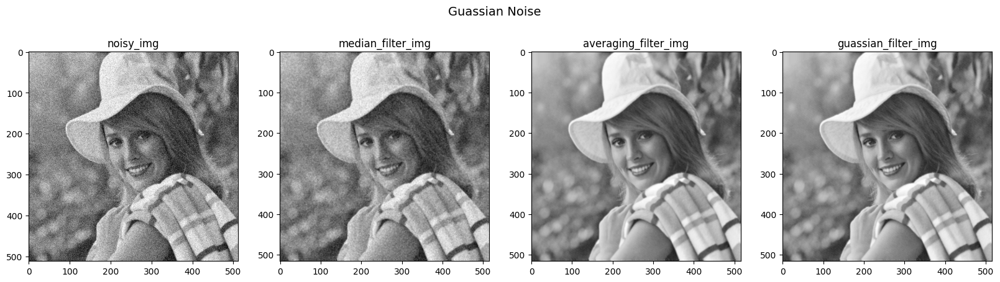

In [ ]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

#add guassian noise to image
sigma = 25
noisy_img = guassian_noise(img.copy(),sigma)

#apply median filter
fs = 3
median_filter_img = median(noisy_img,fs)

#apply averaging filter
fs = 3
averaging_filter = [[1/(fs**2) for i in range(fs)] for j in range(fs)]
averaging_filter_img = filter(img,fs,averaging_filter)

#apply guassian filter
fs = 3
guassian_filter = [[1/16, 1/8, 1/16], [1/8, 1/4, 1/8],[1/16, 1/8, 1/16]]
guassian_filter_img = filter(img,fs,guassian_filter)

#Display
fig, axs = plt.subplots(1,4 , figsize=(20,5))
fig.suptitle("Guassian Noise", fontsize=14)

axs[0].imshow(noisy_img, cmap='gray')
axs[0].set_title(f"noisy_img", fontsize=12)

axs[1].imshow(median_filter_img, cmap='gray')
axs[1].set_title(f"median_filter_img", fontsize=12)

axs[2].imshow(averaging_filter_img, cmap='gray')
axs[2].set_title(f"averaging_filter_img", fontsize=12)

axs[3].imshow(guassian_filter_img, cmap='gray')
axs[3].set_title(f"guassian_filter_img", fontsize=12)

In [ ]:
fs = 3
img_padded = cv2.copyMakeBorder(img,fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
noisy_img_padded = cv2.copyMakeBorder(noisy_img,fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
print(f"MSE noisy_img:{MSE(img_padded,noisy_img_padded)}\nMSE noisy_median:{MSE(median_filter_img,noisy_img_padded)}\nMSE noisy_averaging:{MSE(averaging_filter_img,noisy_img_padded)}\nMSE noisy_guassian:{MSE(guassian_filter_img,noisy_img_padded)}")

MSE noisy_img:611.384033203125
MSE noisy_median:669.0152587890625
MSE noisy_averaging:699.5050659179688
MSE noisy_guassian:704.0404052734375


Text(0.5, 1.0, 'guassian_filter_img')

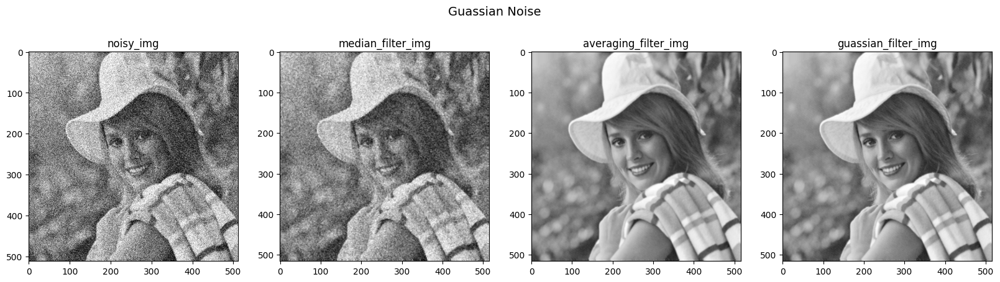

In [ ]:
#diffetent variance
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

#add guassian noise to image
sigma = 50
noisy_img = guassian_noise(img.copy(),sigma)

#apply median filter
fs = 3
median_filter_img = median(noisy_img,fs)

#apply averaging filter
fs = 3
averaging_filter = [[1/(fs**2) for i in range(fs)] for j in range(fs)]
averaging_filter_img = filter(img,fs,averaging_filter)

#apply guassian filter
fs = 3
guassian_filter = [[1/16, 1/8, 1/16], [1/8, 1/4, 1/8],[1/16, 1/8, 1/16]]
guassian_filter_img = filter(img,fs,guassian_filter)

#Display
fig, axs = plt.subplots(1,4 , figsize=(20,5))
fig.suptitle("Guassian Noise", fontsize=14)

axs[0].imshow(noisy_img, cmap='gray')
axs[0].set_title(f"noisy_img", fontsize=12)

axs[1].imshow(median_filter_img, cmap='gray')
axs[1].set_title(f"median_filter_img", fontsize=12)

axs[2].imshow(averaging_filter_img, cmap='gray')
axs[2].set_title(f"averaging_filter_img", fontsize=12)

axs[3].imshow(guassian_filter_img, cmap='gray')
axs[3].set_title(f"guassian_filter_img", fontsize=12)

In [ ]:
fs = 3
img_padded = cv2.copyMakeBorder(img,fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
noisy_img_padded = cv2.copyMakeBorder(noisy_img,fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
print(f"MSE noisy_img:{MSE(img_padded,noisy_img_padded)}\nMSE noisy_median:{MSE(median_filter_img,noisy_img_padded)}\nMSE noisy_averaging:{MSE(averaging_filter_img,noisy_img_padded)}\nMSE noisy_guassian:{MSE(guassian_filter_img,noisy_img_padded)}")

MSE noisy_img:2264.83837890625
MSE noisy_median:2209.945556640625
MSE noisy_averaging:2341.828369140625
MSE noisy_guassian:2346.668212890625


###3.2.3

In [91]:
def depad(img,fs):
  pad = fs-1
  o = list(output)
  for i in range(len(o)):
    o[i] = list(o[i])
    for n in range(pad):
      o[i].pop()
      o[i].pop(0)


  for n in range(pad):
      o.pop()
      o.pop(0)
  return np.array(o)


********************************
image after adding salt and pepper noise:
********************************


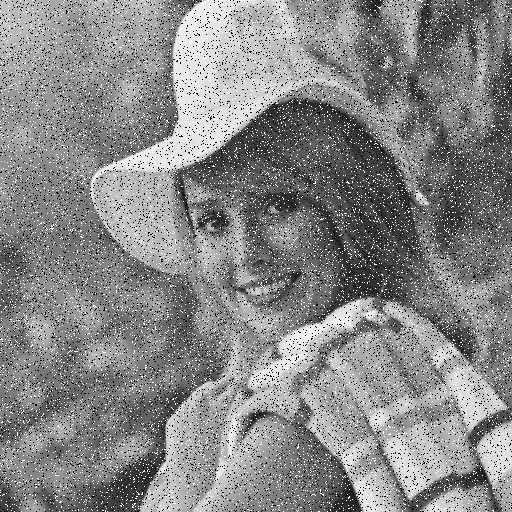

2358.3975

********************************
image after adding guassian noise:
********************************


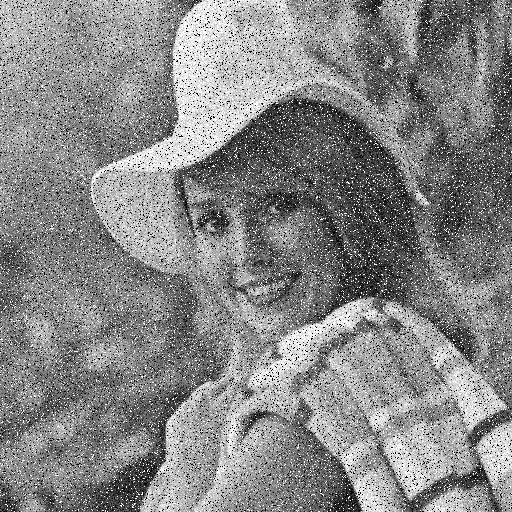

2607.1902


In [136]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

#apply salt and pepper noise
rows,cols = img.shape

density = 70
noisy_img = img.copy()

pixel_rows = np.random.randint(0,rows,int(density*rows))
pixel_cols = np.random.randint(0,cols,int(density*cols))

salt_and_pepper = np.random.randint(0,2,len(pixel_rows))

for i in range(len(pixel_rows)):
  value = salt_and_pepper[i]*255
  noisy_img[pixel_rows[i],pixel_cols[i]] = value


print(f"\n********************************\nimage after adding salt and pepper noise:\n********************************")
cv2_imshow(noisy_img)
print(MSE(img,noisy_img))

#add guassian noise to image
sigma = 25
noisy_img = guassian_noise(noisy_img,sigma)

print(f"\n********************************\nimage after adding guassian noise:\n********************************")

cv2_imshow(noisy_img)
print(MSE(img,noisy_img))

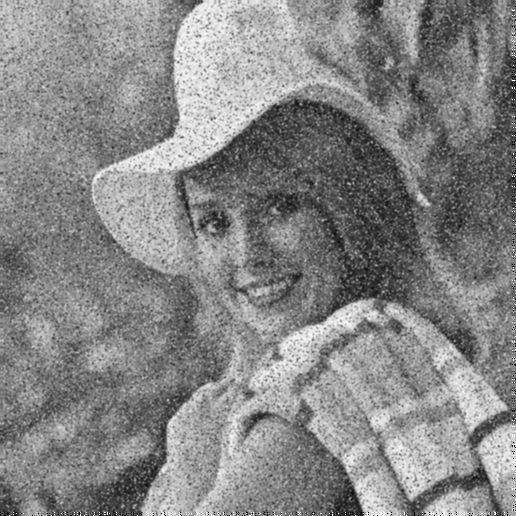

In [145]:
#apply guassian filter on noisy image
fs = 3
guassian_filter = [[1/16, 1/8, 1/16], [1/8, 1/4, 1/8],[1/16, 1/8, 1/16]]
output = filter(noisy_img,fs,guassian_filter)
cv2_imshow(output)

In [146]:
fs = 3
# img_padded = cv2.copyMakeBorder(img,fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
output_depadded = depad(output,fs)
print(MSE(img,output_depadded))

506.88177


In [147]:
output = output_depadded

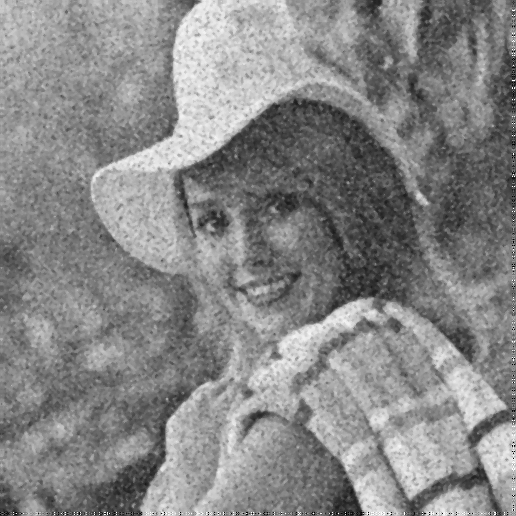

In [148]:
#apply median filter on noisy image
fs = 3
output = median(output,fs)
cv2_imshow(output)

In [149]:
fs = 3
# img_padded = cv2.copyMakeBorder(img,fs-1,fs-1,fs-1,fs-1,cv2.BORDER_REFLECT_101)
output_depadded = depad(output,fs)
print(MSE(img,output_depadded))

423.38266


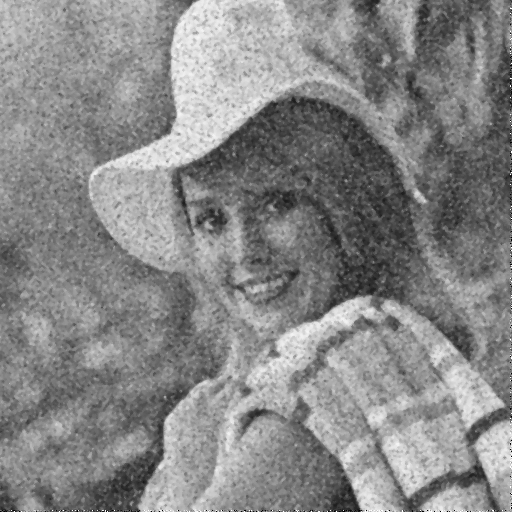

423.38266


In [156]:
#apply guassian filter the median on noisy image
fs = 3
# output = filter(noisy_img,fs,guassian_filter)
output = filter_guassian_mean(noisy_img,fs)
output = depad(output,fs)
cv2_imshow(output)
print(MSE(img,output))

In [152]:
def filter_guassian_mean(img,n):
  rows , cols = img.shape

  img = cv2.copyMakeBorder(img,n-1,n-1,n-1,n-1,cv2.BORDER_REFLECT_101)

  guassian_filter = [[1/16, 1/8, 1/16], [1/8, 1/4, 1/8],[1/16, 1/8, 1/16]]

  #apply guassian
  for r in range(rows):
    for c in range(cols):
      window = img[r:r+n,c:c+n]
      img[r,c] = np.sum(window*guassian_filter)

  #apply median
  for r in range(rows):
    for c in range(cols):
      window = img[r:r+n,c:c+n]
      l = list(set(window.flatten()))
      l.sort()
      img[r,c] = l[int(len(l)//2)]

  return img

##3.4

###3.4.1

Text(0.5, 1.0, 'Filter c')

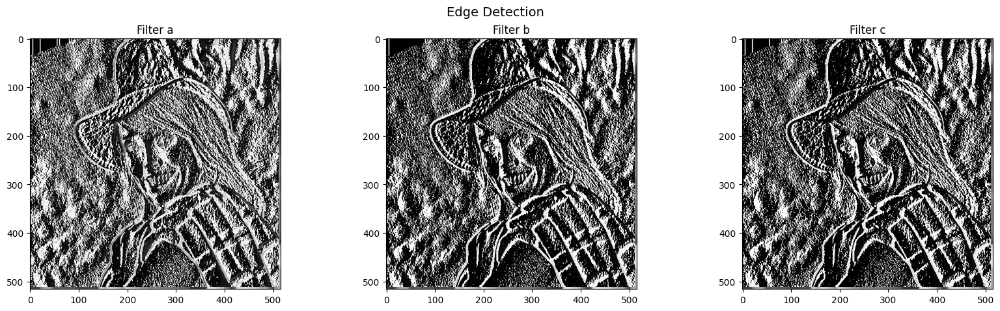

In [160]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

a = [[1/2,0,-1/2],[1/2,0,-1/2],[1/2,0,-1/2]]

b = [[1/6,0,-1/6],[1/6,0,-1/6],[1/6,0,-1/6]]

c = [[1/8,0,-1/8],[2/8,0,-2/8],[1/8,0,-1/8]]

fs = 3

a_img = filter(img,fs,a)

b_img = filter(img,fs,b)

c_img = filter(img,fs,c)

#Display
fig, axs = plt.subplots(1,3 , figsize=(20,5))
fig.suptitle("Edge Detection", fontsize=14)

axs[0].imshow(a_img, cmap='gray')
axs[0].set_title(f"Filter a", fontsize=12)

axs[1].imshow(b_img, cmap='gray')
axs[1].set_title(f"Filter b", fontsize=12)

axs[2].imshow(c_img, cmap='gray')
axs[2].set_title(f"Filter c", fontsize=12)

Text(0.5, 1.0, 'Filter c')

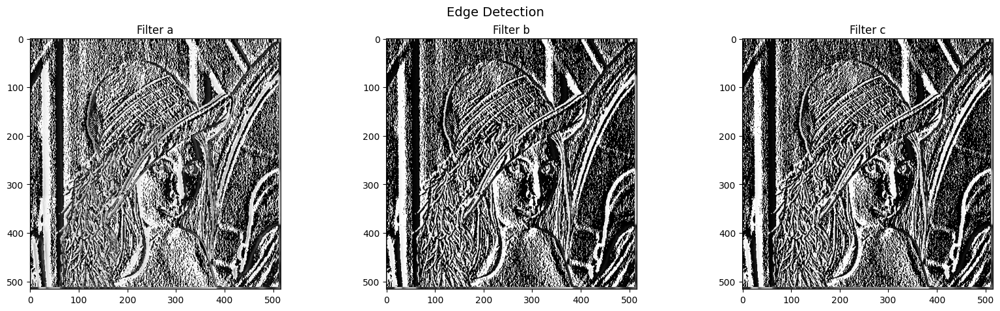

In [158]:
img = cv2.imread("Lena.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

a = [[1/2,0,-1/2],[1/2,0,-1/2],[1/2,0,-1/2]]

b = [[1/6,0,-1/6],[1/6,0,-1/6],[1/6,0,-1/6]]

c = [[1/8,0,-1/8],[2/8,0,-2/8],[1/8,0,-1/8]]

fs = 3

a_img = filter(img,fs,a)

b_img = filter(img,fs,b)

c_img = filter(img,fs,c)

#Display
fig, axs = plt.subplots(1,3 , figsize=(20,5))
fig.suptitle("Edge Detection", fontsize=14)

axs[0].imshow(a_img, cmap='gray')
axs[0].set_title(f"Filter a", fontsize=12)

axs[1].imshow(b_img, cmap='gray')
axs[1].set_title(f"Filter b", fontsize=12)

axs[2].imshow(c_img, cmap='gray')
axs[2].set_title(f"Filter c", fontsize=12)

###3.4.2

Text(0.5, 1.0, 'Filter b')

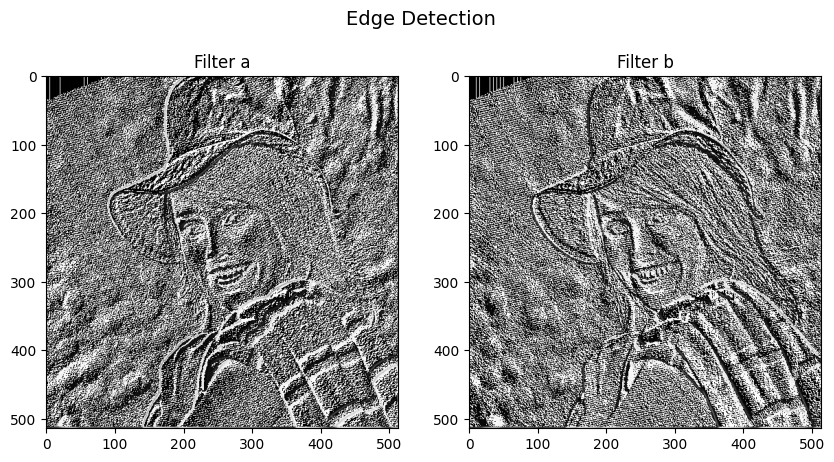

In [170]:
img = cv2.imread("Elaine.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

a = [[1,0],[0,-1]]

b = [[0,1],[-1,0]]

fs = 2

a_img = filter(img,fs,a)

b_img = filter(img,fs,b)

#Display
fig, axs = plt.subplots(1,2 , figsize=(10,5))
fig.suptitle("Edge Detection", fontsize=14)

axs[0].imshow(a_img, cmap='gray')
axs[0].set_title(f"Filter a", fontsize=12)

axs[1].imshow(b_img, cmap='gray')
axs[1].set_title(f"Filter b", fontsize=12)

##3.5

In [232]:
def guassian_filter(kernel_size, sigma=1, muu=0):

    x, y = np.meshgrid(np.linspace(-1, 1, kernel_size),
            np.linspace(-1, 1, kernel_size))
    dst = np.sqrt(x**2+y**2)

    print(1/(2, 0 * np.pi * sigma**2))
    normal = 1/(2, 0 * np.pi * sigma**2)

    guassian = np.exp(-((dst-muu)**2 / (2.0 * sigma**2))) * normal

    return guassian

# kernel_size=5
# gaussian = gaussian_filter(kernel_size)
# print("gaussian filter of{} X {} :".format(kernel_size,kernel_size))
# print(gaussian)


In [248]:
g = np.ones((3,3))
g = g*(1/273)

list

Text(0.5, 1.0, 'Filter 7*7')

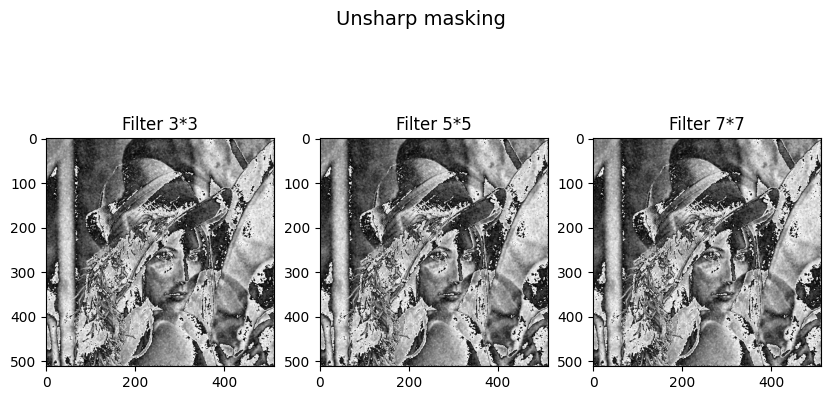

In [269]:
img = cv2.imread("Lena.bmp")
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

fs = 3
guassian_filter_3 = [[1/16, 1/8, 1/16], [1/8, 1/4, 1/8],[1/16, 1/8, 1/16]]

guassian_filter_5 = np.array([[1,4,7,4,1], [4,16,26,16,4],[7,26,41,25,7],[4,16,26,16,4],[1,4,7,4,1]])
guassian_filter_5 = guassian_filter_5*(1/273)

guassian_filter_7 = np.array([[0,0,1,2,1,0,0], [0,3,13,22,13,3,0],[1,13,59,97,59,13,1],[2,22,97,159,97,22,2],[1,13,59,97,59,13,1],[0,3,13,22,13,3,0],[0,0,1,2,1,0,0]])
guassian_filter_7 = guassian_filter_7*1/1003

# guassian = cv2.getGaussianKernel(3,1)
smoothed_img_3 = filter(img,3,guassian_filter_3)
smoothed_img_5 = filter(img,5,guassian_filter_5)
smoothed_img_7 = filter(img,7,guassian_filter_7)

# img = padding(img,1)
# unsharp_img_3 = img - smoothed_img_3
# unsharp_img_5 = img - smoothed_img_5
# unsharp_img_7 = img - smoothed_img_7

unsharp_img_3 = img - depad(smoothed_img_3,1)
unsharp_img_5 = img - depad(smoothed_img_5,1)
unsharp_img_7 = img - depad(smoothed_img_7,1)

k = 1

output_3 = img +  k*(unsharp_img_3)
output_5 = img +  k*(unsharp_img_5)
output_7 = img +  k*(unsharp_img_7)



#Display
fig, axs = plt.subplots(1,3 , figsize=(10,5))
fig.suptitle("Unsharp masking", fontsize=14)

axs[0].imshow(output_3, cmap='gray')
axs[0].set_title(f"Filter 3*3", fontsize=12)

axs[1].imshow(output_5, cmap='gray')
axs[1].set_title(f"Filter 5*5", fontsize=12)

axs[2].imshow(output_7, cmap='gray')
axs[2].set_title(f"Filter 7*7", fontsize=12)